In [2]:
import pypsa
import openpyxl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import matplotlib.patches as mpatches
from pypsa.plot import projected_area_factor
from matplotlib.patches import Circle, Ellipse, Patch
from matplotlib.legend_handler import HandlerPatch
from matplotlib.lines import Line2D
import cartopy.crs as ccrs
import cartopy
import geopandas as gpd
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['hatch.linewidth'] = 0.2

In [3]:
from matplotlib import cm
import matplotlib

norm = matplotlib.colors.Normalize(vmin=0, vmax=1)
color_list=[cm.plasma(norm(j),bytes=True) for j in np.arange(0.55,1,0.09) ]
new_colors=[tuple([i/255.0 for i in j]) for j in color_list]

color_list=[cm.Oranges(norm(j),bytes=True) for j in np.arange(0.55,1,0.09) ]
orange_colors=[tuple([i/255.0 for i in j]) for j in color_list]

tech_colors= {
    'Transmission lines': "grey",
     'transmission': "grey",
    'Battery storage' : '#80c944' ,
    'battery storage' : '#80c944' ,
    'Battery store' : '#80c944' ,
    'battery charger' : '#80c944' ,
    'battery discharger' : 'darkgreen' , 
    'battery' : 'darkgreen' ,        
    'Home battery storage' : '#ace37f'  ,
    'Home battery store' : '#ace37f'  ,
    'home battery charger' : '#ace37f'  ,
    'home battery discharger' : '#ace37f' ,    
    'home battery' : '#ace37f' ,    
    'H2 Fuel Cell': '#c251ae',
    'H2 Electrolysis': '#ff29d9',
    'H2 pipeline' : 'plum',
     'H2 pipeline retrofitted' :'plum',
    'SMR': '#870c71',
    'SMR CC': '#4f1745',
    'Sabatier' : '#4f1745',
    'urban central solid biomass CHP':'darkolivegreen',
    'helmeth' : '#4f1745',
    'co2':'linen',
    'co2 vent':'linen',
    'co2 stored':'peachpuff',
    'Electricity distribution grid': 'darkgrey',
    'electricity distribution grid': 'darkgrey',
    'distribution grid': 'darkgrey',
    'uranium': '#ff8c00',
    "onwind": "#235ebc",
    "Onshore wind": "#235ebc",
    "Onshore Wind": "#235ebc" , 
    "onshore wind": "#235ebc",
    'offwind': "#6895dd",
    'offwind-ac': "#6895dd",
    'Offshore wind': "#6895dd",
    'offshore wind': "#6895dd",
    'offshore wind ac': "#6895dd",
    'offwind-dc': "#74c6f2",
    'offshore wind dc': "#74c6f2",
    "Hydroelectricity": "#08ad97",
    "hydro": "#08ad97",
    "hydro+PHS": "#08ad97",
    "PHS": "teal",
    "Pumped hydro storage": "teal",
    "hydro reservoir": "#08ad97",
    'hydroelectricity': '#08ad97',
    "ror": "#4adbc8",
    "Run of river": "#4adbc8",
    'Solar': "#f9d002",
    'Solar utility': "#f9d002",
    'solar': "#f9d002",
    'solar PV': "#f9d002",
    'Solar rooftop' : 'orange',
    'solar rooftop' : 'orange',
    'solar thermal': '#ffef60',
    'biomass': '#0c6013',
    'biomass boiler': '#0c6013',
    'biogas': '#23932d',
    'waste': '#68896b',
    'geothermal': '#ba91b1',
    "OCGT": "#d35050",
    "gas storage": "crimson", 
    "gas store": "crimson", 
    "CCGT": "#d35050",
    "natural gas": "#d35050",
    "CCGT": "#b20101",
    "Nuclear": "rosybrown",
    "nuclear": "rosybrown",
    "coal": "black", #"#707070",
    "lignite": "#9e5a01",
    "H2 storage": "#ea048a",
    "hydrogen storage": "#ea048a",
    "battery": "#b8ea04",
    "Electric load": "#f9d002",
    "industry electricity": "dimgrey",
    "lines": "#70af1d",
    "transmission lines": "#70af1d",
    "AC-AC": "#70oil toaf1d",
    "AC line": "#70af1d",
    "AC": "#70af1d",
    "electricity": "#70af1d",
    "links": "#8a1caf",
    "HVDC links": "#8a1caf",
    "DC-DC": "#8a1caf",
    "DC": "#8a1caf",
    "DC link": "#8a1caf",
    'Solar thermal': '#ffef60',
    "oil boiler": "#b9cc81",
    "Oil to power/heat": "#7d7103",
    "Oil": "#7d7103",
    "Gas to power/heat": "#d35050",
    "Oil and gas to power/heat": "#d35050",
    "Oil/gas/biomass to power/heat": "#d35050",
    "Oil and gas to heat": "salmon",
    "Coal": "black", #"#707070",
    "Power to liquid": '#4f1745',
    "methanolisation": '#4f1745',
    "Power to gas":'#870c71',
    "Power to heat":'maroon',
    "Biomass":'#06540d',
    "Biomass store":'#06540d',
    "Biomass storage":'#06540d',
    "Biogas":'#23932d',
    "Biogas store":'#23932d',
    "Biogas storage":'#23932d',
    "BEV charger":'rebeccapurple',
    'EV battery':'mediumslateblue',
    "V2G":'mediumpurple',
    "DAC":'lightcoral',
    "Heat storage":"brown",
    "Heat store":"brown",
     "gas CHP": "maroon",
     "CHP": "maroon",
     "biomass CHP": "darkolivegreen",
     "biomass boiler/CHP": "darkolivegreen",
     "resistive heater": "indianred",
     "air heat pump": "chocolate",
     "ground heat pump": "sandybrown",
    'industry' : 'black',
    'industry gas' : 'darkred',
    'gas for industry' : 'darkred',
    'gas for industry CC' : 'red',
    'industry biomass' : 'olive',
    "Fischer-Tropsch":"#5a86ad",
    'biogas to gas':'greenyellow',
    "heat pump":'darkslategrey',
    "gas for power" : "red",
    "gas boiler": "crimson", 
    "industry": 'black',
    'H2 Store':'purple',
    'H2':'purple',
    'load':'black',
    'solar-delta': 'yellow',
    'Solar-Delta': 'yellow',
    'solar-Delta': 'yellow',
    'Solar-delta': 'yellow',
    'solar-delta10': 'yellow',
    'solar-delta20': 'yellow',
    'solar-hsat inv': 'goldenrod' ,
    'Solar-HSAT': 'goldenrod',
    'Solar HSAT': 'darkgoldenrod',
    'solar-hsat': 'tomato',
    'solar-hsat-inv-1.3':'red' ,# 'salmon' ,
    'solar-hsat-inv-1.5': "darkred",#'red' ,
    'solar-hsat-inv-1.7': 'orangered',
    "solar-hsat-inv-1.9": "darkred",
    "solar-E": "khaki",
    "solar-E-10": "khaki",
    "solar-E-20": "khaki",
    'solar-E-60':'darkkhaki',
    'solar-SE':'lightsalmon' ,
    'solar-SW':'darksalmon',
    'solar-W':'peachpuff',
    'solar-W-10':'peachpuff',
    'solar-W-20':'peachpuff',
    'solar-W-60':"#ffa756",  #pale orange
    "solar rooftop east": "khaki",
    'solar rooftop east_60':'darkkhaki',
    'solar rooftop southeast':'lightsalmon' ,
    'solar rooftop southwest':'darksalmon',
    'solar rooftop southeast-inv-1.9':'lightsalmon' ,
    'solar rooftop southwest-inv-1.9':'darksalmon',
    'solar rooftop west':'peachpuff',
    'solar rooftop west_60':'sandybrown',
    'solar rooftop delta': 'yellow',
    'solar rooftop delta10': 'olive',
    'solar rooftop delta20': 'darkkhaki',
    'solar rooftop-delta': 'olive',
    'solar-inv':'darkgoldenrod',
    'solar inv': "#f9d002",#'darkgoldenrod',
    'solar rooftop-inv': 'salmon',
    'solar-inv-1.3': new_colors[1], #'yellow',
    'solar-inv-1.5': 'goldenrod', #new_colors[2], #'yellow',
    'solar-inv-1.7': 'darkgoldenrod', #new_colors[3], #'yellow',
    "solar-inv-1.9": 'darkgoldenrod' ,#new_colors[4], #'yellow',
    'solar rooftop-inv-1.3': 'yellow',
    'solar rooftop-inv-1.5': 'darkorange' ,
    'solar rooftop-inv-1.7': orange_colors[1],
    "solar rooftop-inv-1.9": "khaki",
    'agriculture machinery oil': "#606602",
    'kerosene for aviation': "dimgrey",
    'land transport oil': "darkkhaki",
    'naphtha for industry': "lightgray",
    'shipping methanol': "darkslategrey",
     "shipping oil": "navy",
    'gas pipeline new': 'darkred',
    'gas pipeline': 'darkred',
    'solid biomass transport':'#06540d',
    'CO2 pipeline' :'gold' , 
    'co2 sequestered' :'thistle' , 
    'process emissions': 'olive',
    'process emissions CC': 'olivedrab',
    'offshore wind (AC)': "#6895dd",
    'offshore wind ac': "#6895dd",
    'offwind-dc': "#74c6f2",
    'offshore wind (DC)': "#74c6f2",
    'rural heat': '#ff5c5c',
    'urban central heat': '#d15959',
    'urban decentral heat': '#a33c3c',
    'urban central heat vent': '#a74747',
    'low-temperature heat for industry': '#8f2727',
    'agriculture heat': '#d9a5a5',
    'H2 for industry': "#f073da",
    'H2 for shipping': "#ebaee0",
    'agriculture electricity': '#494778',
    'solid biomass for industry': '#7a6d26',
    'land transport EV': '#baf238',
    'stores-oil' : 'grey',
    'methanol' : "#5a86ad",#'brown',#'#5a86ad',
    'solid biomass':'g', #'#06540d',
    "oil": "#7d7103", #'y',#"#262626",
    "electricity": 'grey', #''b',#"#f9d002",
    'hydrogen' : 'plum', #'m',#'plum',
    "gas": "#d35050", #'r',#
    "gas boilers" : 'darkred' ,

}

In [4]:
opt_name = {
    "Store": "e",
    "Line": "s",
    "Transformer": "s"
}
def calculate_costs(n, label, costs):

    for c in n.iterate_components(n.branch_components|n.controllable_one_port_components^{"Load"}):
        capital_costs = c.df.capital_cost*c.df[opt_name.get(c.name,"p") + "_nom_opt"]
        capital_costs_grouped = capital_costs.groupby(c.df.carrier).sum()

        capital_costs_grouped = pd.concat([capital_costs_grouped], keys=["capital"])
        capital_costs_grouped = pd.concat([capital_costs_grouped], keys=[c.list_name])

        costs = costs.reindex(capital_costs_grouped.index.union(costs.index))

        costs.loc[capital_costs_grouped.index, label] = capital_costs_grouped

        if c.name == "Link":
            p = c.pnl.p0.multiply(n.snapshot_weightings.generators, axis=0).sum()
        elif c.name == "Line":
            continue
        elif c.name == "StorageUnit":
            p_all = c.pnl.p.multiply(n.snapshot_weightings.generators, axis=0)
            p_all[p_all < 0.] = 0.
            p = p_all.sum()
        else:
            p = c.pnl.p.multiply(n.snapshot_weightings.generators, axis=0).sum()

        #correct sequestration cost
        if c.name == "Store":
            items = c.df.index[(c.df.carrier == "co2 stored") & (c.df.marginal_cost <= -100.)]
            c.df.loc[items, "marginal_cost"] = -20.

        marginal_costs = p*c.df.marginal_cost

        marginal_costs_grouped = marginal_costs.groupby(c.df.carrier).sum()

        marginal_costs_grouped = pd.concat([marginal_costs_grouped], keys=["marginal"])
        marginal_costs_grouped = pd.concat([marginal_costs_grouped], keys=[c.list_name])

        costs = costs.reindex(marginal_costs_grouped.index.union(costs.index))

        costs.loc[marginal_costs_grouped.index,label] = marginal_costs_grouped

    # add back in all hydro
    #costs.loc[("storage_units", "capital", "hydro"),label] = (0.01)*2e6*n.storage_units.loc[n.storage_units.group=="hydro", "p_nom"].sum()
    #costs.loc[("storage_units", "capital", "PHS"),label] = (0.01)*2e6*n.storage_units.loc[n.storage_units.group=="PHS", "p_nom"].sum()
    #costs.loc[("generators", "capital", "ror"),label] = (0.02)*3e6*n.generators.loc[n.generators.group=="ror", "p_nom"].sum()

    return costs

def generation(n, carriers=None):

    dispatch = n.generators_t.p 

    generation = n.snapshot_weightings.generators @ (dispatch) #n.snapshot_weightings.generators

    generation = (
        generation.groupby([n.generators.bus.map(n.buses.location), n.generators.carrier])
        .sum()
        .unstack()
    )
    
    links_gen= (-1) *n.snapshot_weightings.generators @(n.links_t.p1)
    links_gen = (links_gen.groupby([n.links.bus1.map(n.buses.location), n.links.carrier])
        .sum()
        .unstack()
    )
    for i in links_gen['nuclear'].index:
      if 'EU' not in i :  
            generation.loc[ ( i, "nuclear" ) ]=links_gen['nuclear'].loc[i]
    for i in links_gen['OCGT'].index:
            generation.loc[ ( i, "gas" ) ]=links_gen['OCGT'].loc[i] + links_gen['CCGT'].loc[i]        

    if carriers is not None:
        generation = generation[carriers]

    return generation.drop("EU", axis=0).stack().div(1e6)

carriers = {
        "offwind-ac": "Offshore Wind (AC)",
        "offwind-dc": "Offshore Wind (DC)",
        "onwind": "Onshore Wind",
        "ror": "Run of River",
        "solar": "Utility-scale Solar PV",
        "solar rooftop": "Rooftop Solar PV",
        "solar-h": "H-tracking Solar PV",
        #"solar-th": "TH-tracking Solar PV",
        "solar-delta": "Delta-shaped Solar PV",
        "nuclear" : 'Nuclear'
    }

from pypsa.plot import projected_area_factor
from matplotlib.patches import Circle, Ellipse, Patch
from matplotlib.legend_handler import HandlerPatch
from matplotlib.lines import Line2D

class HandlerCircle(HandlerPatch):
    """
    Legend Handler used to create circles for legend entries.

    This handler resizes the circles in order to match the same dimensional
    scaling as in the applied axis.
    """

    def create_artists(
        self, legend, orig_handle, xdescent, ydescent, width, height, fontsize, trans
    ):
        fig = legend.get_figure()
        ax = legend.axes

        unit = np.diff(ax.transData.transform([(0, 0), (1, 1)]), axis=0)[0][1]
        radius = orig_handle.get_radius() * unit * (72 / fig.dpi)
        center = 5 - xdescent, 3 - ydescent
        p = plt.Circle(center, radius)
        self.update_prop(p, orig_handle, legend)
        p.set_transform(trans)
        return [p]


def make_legend_circles_for(sizes, scale=1.0, **kw):
    return [Circle((0, 0), radius=(s / scale)**0.5, **kw) for s in sizes]

def add_legend_circles(
    ax, sizes, labels, scale=1, srid=None, patch_kw={}, legend_kw={}
):

    if srid is not None:
        area_correction = projected_area_factor(ax, n.srid) ** 2
        sizes = [s * area_correction for s in sizes]

    handles = make_legend_circles_for(sizes, scale, **patch_kw)

    legend = ax.legend(
        handles, labels, handler_map={Circle: HandlerCircle()}, **legend_kw
    )

    ax.add_artist(legend)


def add_legend_lines(ax, sizes, labels, scale=1, patch_kw={}, legend_kw={}):

    handles = [Line2D([0], [0], linewidth=s / scale, **patch_kw) for s in sizes]

    legend = ax.legend(handles, labels, **legend_kw)

    ax.add_artist(legend)


def add_legend_patch(ax, colors, labels, patch_kw={}, legend_kw={}):

    handles = [Patch(facecolor=c, **patch_kw) for c in colors]

    legend = ax.legend(handles, labels, **legend_kw)

    ax.add_artist(legend)

#gen = generation(n, carriers.keys())

In [5]:
def nodal_balance(n, carrier, time=slice(None), aggregate=None, energy=True):

    if not isinstance(carrier, list):
        carrier = [carrier]

    one_port_data = {}

    for c in n.iterate_components(n.one_port_components):

        df = c.df[c.df.bus.map(n.buses.carrier).isin(carrier)]

        if df.empty:
            continue

        s = c.pnl.p.loc[time, df.index] * df.sign

        s = s.groupby([df.bus.map(n.buses.location), df.carrier], axis=1).sum()

        one_port_data[c.list_name] = s

    branch_data = {}

    for c in n.iterate_components(n.branch_components):
        for col in c.df.columns[c.df.columns.str.startswith("bus")]:

            end = col[3:]

            df = c.df[c.df[col].map(n.buses.carrier).isin(carrier)]

            if df.empty:
                continue

            s = -c.pnl[f"p{end}"].loc[time, df.index]

            s = s.groupby([df[col].map(n.buses.location), df.carrier], axis=1).sum()

            branch_data[(c.list_name, end)] = s

    branch_balance = pd.concat(branch_data).groupby(level=[0, 2]).sum()
    one_port_balance = pd.concat(one_port_data)

    def skip_tiny(df, threshold=1e-1):
        return df.where(df.abs() > threshold)

    branch_balance = skip_tiny(branch_balance)
    one_port_balance = skip_tiny(one_port_balance)

    balance = pd.concat([one_port_balance, branch_balance]).stack(level=[0, 1])

    balance.index.set_names(["component", "bus"], level=[0, 2], inplace=True)

    if energy:
        balance = balance * n.snapshot_weightings.generators

    if aggregate is not None:
        keep_levels = balance.index.names.difference(aggregate)
        balance = balance.groupby(level=keep_levels).sum()

    return balance



In [6]:
import logging
import sys

import numpy as np
import pandas as pd
import pypsa
#from prepare_sector_network import prepare_costs

idx = pd.IndexSlice
logger = logging.getLogger(__name__)
opt_name = {"Store": "e", "Line": "s", "Transformer": "s"}


def assign_carriers(n):
    if "carrier" not in n.lines:
        n.lines["carrier"] = "AC"


def assign_locations(n):
    for c in n.iterate_components(n.one_port_components | n.branch_components):
        ifind = pd.Series(c.df.index.str.find(" ", start=4), c.df.index)
        for i in ifind.unique():
            names = ifind.index[ifind == i]
            c.df.loc[names, "location"] = "" if i == -1 else names.str[:i]
            
def calculate_nodal_capacities(n, label, nodal_capacities):
    # Beware this also has extraneous locations for country (e.g. biomass) or continent-wide (e.g. fossil gas/oil) stuff
    for c in n.iterate_components(
        n.branch_components | n.controllable_one_port_components ^ {"Load"}
    ):
        nodal_capacities_c = c.df.groupby(["location", "carrier"])[
            opt_name.get(c.name, "p") + "_nom_opt"
        ].sum()
        index = pd.MultiIndex.from_tuples(
            [(c.list_name,) + t for t in nodal_capacities_c.index.to_list()]
        )
        nodal_capacities = nodal_capacities.reindex(index.union(nodal_capacities.index))
        nodal_capacities.loc[index, label] = nodal_capacities_c.values

    return nodal_capacities



In [5]:
## Myopic runs


In [6]:
## Sector-cooupled with equity for all sectors, 37 nodes, 2hr resolution, 10% Tr. expansion
## carobn budget :1.7 

main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'Base']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'Base w Equity']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar w Eqiuty']  ,

}


## Figure 1.a (+ Supp. Figure 8)

In [11]:
#script to generate cost+capacities
results_new=pd.DataFrame({})
results_total=pd.DataFrame({})

scen_costs={}
costs=pd.DataFrame({})

for scen in main_scen.keys():
  for  year in main_scen[scen][0]:
    scenario=scen.format(str(year))
    n=pypsa.Network(scenario)
    result_new = pd.concat([pd.Series(n.links.p_nom_opt.filter(like=str(year)).groupby([n.links.carrier]).sum())
                                 ,pd.Series(n.storage_units.p_nom_opt.filter(like=str(year)).groupby([n.storage_units.carrier]).sum())
                                 ,pd.Series(n.generators.loc[[i for i in n.generators.index if
             n.generators.carrier[i] not in ['coal','lignite','oil','gas']]].p_nom_opt.filter(like=str(year)).groupby([n.generators.carrier]).sum())
                    ,pd.Series({'Total-cost' : n.objective/1e09})
                                            ])
    result_total = pd.concat([pd.Series(n.links.groupby("carrier").p_nom_opt.sum())
                                 ,pd.Series(n.storage_units.groupby("carrier").p_nom_opt.sum())
                                 ,pd.Series(n.generators.loc[[i for i in n.generators.index if
             n.generators.carrier[i] not in ['coal','lignite','oil','gas']]].groupby("carrier").p_nom_opt.sum())
                    ,pd.Series({'Total-cost' : n.objective/1e09})
                                            ])

    results_total[scenario]=result_total.groupby(result_total.index).sum() 
    #.drop(labels = [ 'DC',
     #                              'SMR', 'SMR CC','Sabatier','helmeth',  #,'co2 vent'
      #                                            'gas','uranium'
       #                                           ,'coal','lignite','oil'])
    results_new[scenario]=result_new.groupby(result_new.index).sum() 
    #.drop(labels = [ 
     #                              'SMR', 'SMR CC','Sabatier','helmeth'  #,'co2 vent' DC gas uranium not in new installed
      #                                            ,'coal','lignite','oil'])
    
    scen_costs[scenario] = (calculate_costs(n,'capital+marginal',costs).sum(axis=1)).groupby(level=2).sum().div(1e9)  #in billiion Euros
    scen_costs[scenario] = scen_costs[scenario].rename(index={
                          'battery':'Battery storage','battery charger':'Battery storage','battery discharger':'Battery storage',
                          'home battery':'Home battery storage','home battery charger':'Home battery storage','home battery discharger':'Home battery storage',                                                       
                          'offwind':'Offshore wind', 'offwind-ac':'Offshore wind','offwind-dc':'Offshore wind', 'onwind':'Onshore wind',
                          'AC':'Transmission lines'  , 'DC':'Transmission lines','ror': 'Run of river',
                          'hydro':'Hydroelectricity' , 'nuclear':'Nuclear','uranium':'Nuclear',
                          'solar':'Solar utility', 'solar rooftop':'Solar rooftop',
                          'electricity distribution grid' : 'Electricity distribution grid',
                           'PHS' : 'Pumped hydro storage', 'H2':'H2 storage',
                           'SMR':'Power to gas'  , 'SMR CC':'Power to gas','oil': 'Oil to power/heat',
                           'Fischer-Tropsch':'Power to liquid', 'methanolisation':'Power to liquid',
                           'Sabatier':'Power to gas', 'helmeth':'Power to gas', 'coal' : 'Coal', 'lignite' :'Coal',
                            "solar-delta": "Solar-delta",

                          })  # co2 vent','co2','co2 stored',
    for ix in scen_costs[scenario].index :   
                if 'resistive heater' in ix or 'heat pump' in ix :
                    scen_costs[scenario] =scen_costs[scenario].rename(index={ix : 'Power to heat',})
                if  any(w in ix for w in ['gas', 'OCGT', 'CCGT'])  :
                    scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Gas to power/heat',})
                if 'biomass' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Biomass',})
                if 'biogas' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Biogas',})
                if 'oil' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Oil to power/heat',})
                if 'solar thermal' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Solar thermal',})
                if 'water tank' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Heat storage',})
                #if 'biogas' in ix :scen_costs[scenario].rename(index={ix:'Biomass',})
                if 'solar-hsat' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Solar-HSAT',})
                if 'solar-inv' in ix :scen_costs[scenario] =scen_costs[scenario].rename(index={ix:'Solar utility',})
                    
    scen_costs[scenario]=scen_costs[scenario].groupby(scen_costs[scenario].index).sum() 

        

In [12]:
preferred_order = pd.Index(
    [
        "Transmission lines",
        "Electricity distribution grid",
        "Oil to power/heat",
        "Gas to power/heat",
        "Coal",
        "Power to liquid",
        "Power to gas",
        "Biomass",
        "Biogas",
        "BEV charger",
        "V2G",
        "DAC",
        "Power to heat",
        "Heat storage",
        "H2 storage",
        "H2 pipeline",
        "H2 Electrolysis",
        "H2 Fuel Cell",
        "Pumped hydro storage",
        "Hydroelectricity",
        "Run of river",
        "Nuclear",
        "Onshore wind",
        "Offshore wind",
        "Battery storage",
        "Home battery storage",
        "Solar thermal",
        "Solar utility",
        "Solar-HSAT",
        "Solar-delta",
        "Solar rooftop",
    ]
)


for  scenario in reversed(scen_costs.keys()) :
    costs[scenario]=pd.DataFrame(scen_costs[scenario].drop(labels =['co2','co2 stored'
                                                                   ]))
                                                                  #  'co2 vent',,'oil','uranium','lignite','coal','gas' ]) ) 
                                                        #   ['SMR', 'SMR CC','Sabatier','co2 vent','co2','co2 stored',
                                                   #    'helmeth', 'oil','uranium','lignite','coal','gas', 'CCGT','OCGT'
                                                  #  ]) ) #dropping all the variables not visible in figure
    

order = preferred_order.intersection(costs[scenario].index).append(
        costs[scenario].index.difference(preferred_order))    
costs=costs.reindex(order)   
costs=costs.drop(labels =['process emissions','process emissions CC','Li ion','methanol'])
costs=costs.fillna(0)
#results=results.fillna(0)

2025 base with new solar - base:  -0.41%
2025 equity with new solar - equity:  -0.5%
2030 base with new solar - base:  -0.82%
2030 equity with new solar - equity:  -0.51%
2035 base with new solar - base:  -1.37%
2035 equity with new solar - equity:  -1.32%
2040 base with new solar - base:  -1.24%
2040 equity with new solar - equity:  -1.27%
2045 base with new solar - base:  -1.68%
2045 equity with new solar - equity:  -1.68%
2050 base with new solar - base:  -1.64%
2050 equity with new solar - equity:  -1.67%


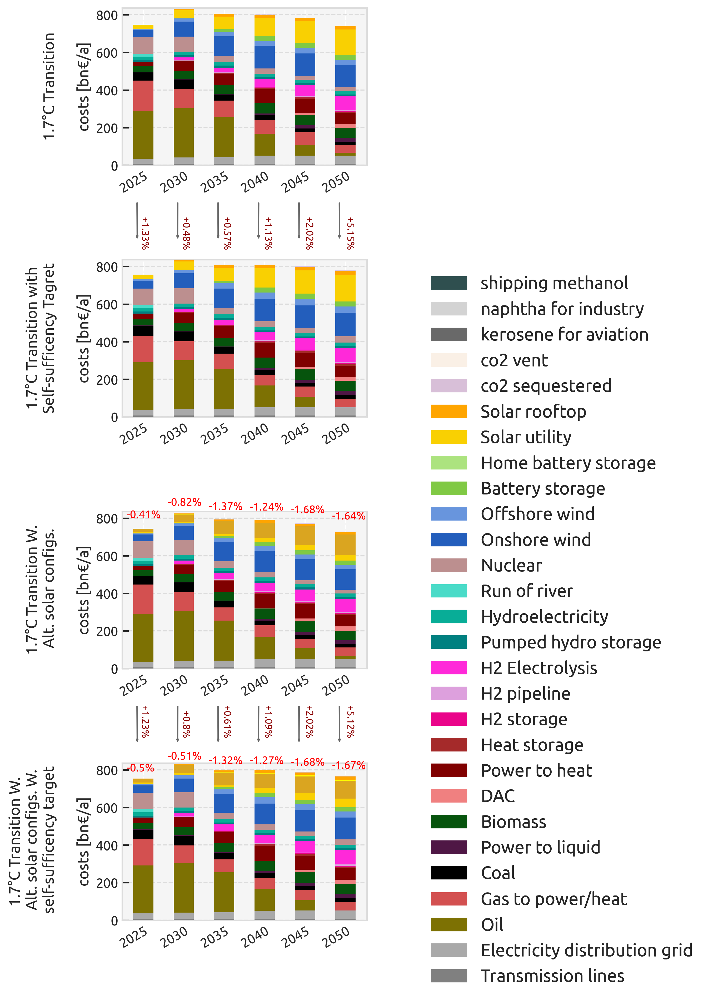

In [35]:
## Equity withoutOCGT/boilers/CHP as local production
## Suup. figure


plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['hatch.linewidth'] = 0.2#
plt.rcParams['figure.dpi'] = 300

def add_arrow(ax0, ax1, pos0, pos1, **arrow_kwargs):
    ax0tr = ax0.transData  # Axis 0 -> Display
    ax1tr = ax1.transData  # Axis 1 -> Display
    figtr = fig.transFigure.inverted()  # Display -> Figure
    ptB = figtr.transform(ax0tr.transform(pos0))
    ptE = figtr.transform(ax1tr.transform(pos1))
    arrow = FancyArrowPatch(
        ptB,
        ptE,
        transform=fig.transFigure,  # Place arrow in figure coord system
        **arrow_kwargs,
    )
    fig.patches.append(arrow)
#arrow_style = dict(arrowstyle="simple", mutation_scale=5, ec=None)
arrow_style = ArrowStyle('Fancy', head_length=2, head_width=1.5, tail_width=0.5)
    
fig, axs = plt.subplots(4,1,figsize=(4,15), sharey=True)
fig.subplots_adjust(hspace=0.6)
fig.subplots_adjust(wspace=0.5)

bar_width=0.5
index=np.arange(6) #np.arange(len(main_scen[scen][0])) 

hatches=['','...']
#costs=costs.drop(labels =['co2 sequestered','co2 vent',
                         # 'shipping methanol','naphtha for industry','kerosene for aviation',
                        # ])




for i,base in enumerate(main_scen.keys()):
    for k, year in  enumerate(main_scen[base][0]):
            scenario=base.format(str(year))
            bottom=0
            axs[i].grid(axis = 'y',color='gainsboro', zorder=0)
            for color, component in enumerate(costs[scenario].index):
                axs[i].bar(index[k], costs[scenario][component] , bar_width, bottom=bottom,
                           color=tech_colors[component], zorder=3, edgecolor = "none")  #hatch=hatches[j], edgecolor='white'
                bottom+=costs[scenario][component]

    xlabels = [i for i in main_scen[base][0]]
            #axs[i].set_xlabel("", rotation=0)
    axs[i].set_xticks((index))    
    axs[i].set_xticklabels(xlabels,fontsize=12, rotation=30,ha='right', rotation_mode='anchor')
    axs[i].tick_params(axis='y', labelsize=12)
    axs[i].set_yticks(np.arange(0, 801, 200)) 

axs[0].set_ylabel('1.7\xb0C Transition\n\ncosts [bn€/a]',fontsize=14, fontname = 'Ubuntu',)
axs[1].set_ylabel('1.7\xb0C Transition with\nSelf-sufficency Tagret\n\ncosts [bn€/a]',fontsize=14, fontname = 'Ubuntu')
axs[2].set_ylabel('1.7\xb0C Transition W.\n Alt. solar configs.\n\ncosts [bn€/a]',fontsize=14, fontname = 'Ubuntu')
axs[3].set_ylabel('1.7\xb0C Transition W.\n Alt. solar configs. W.\n self-sufficency target\n\ncosts [bn€/a]',fontsize=14, fontname = 'Ubuntu')

legend_manual=[]
for key in (costs[scenario].index):
  if key not in ['Solar thermal','H2 Fuel Cell','V2G','BEV charger','Home bettery storage',
                'Solar-delta','Solar-HSAT',
                ]:
    legend_manual.append(mpatches.Patch(color=tech_colors[key], label=key))
legend1=plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1.2, 4.2),ncol=1,
           fontsize=16,frameon=False)
plt.gca().add_artist(legend1)

for i, year in enumerate([2025,2030, 2035,2040,2045,2050]): #,2050]):
    bases = list(main_scen.keys())
    fig.text(0.18+0.13*i, 0.677,
           #  "+ "+str(round(scen_costs[bases[1].format(str(year))].sum()-
              #                                scen_costs[bases[0].format(str(year))].sum(),2))
         #+" bn€\n "+
          '+'+str(round(100*((scen_costs[bases[1].format(str(year))].sum()/
                                     scen_costs[bases[0].format(str(year))].sum())-1),2))+"%", 
         fontsize=9 ,rotation =270,  color='darkred')
    
    fig.text(0.18+0.13*i, 0.265,
           #  "+ "+str(round(scen_costs[bases[1].format(str(year))].sum()-
              #                                scen_costs[bases[0].format(str(year))].sum(),2))
         #+" bn€\n "+
          '+'+str(round(100*((scen_costs[bases[3].format(str(year))].sum()/
                                     scen_costs[bases[2].format(str(year))].sum())-1),2))+"%", 
         fontsize=9, rotation =270,  color='darkred')
    
    print(str(year), 'base with new solar - base: ' , str(round(100*((scen_costs[bases[2].format(str(year))].sum()/
                                     scen_costs[bases[0].format(str(year))].sum())-1),2))+"%",)
    
    print(str(year), 'equity with new solar - equity: ' , str(round(100*((scen_costs[bases[3].format(str(year))].sum()/
                                     scen_costs[bases[1].format(str(year))].sum())-1),2))+"%",)
    
    fig.text(0.14+0.13*i, 0.36 +scen_costs[bases[2].format(str(year))].sum()*0.00012,
          str(round(100*((scen_costs[bases[2].format(str(year))].sum()/
                                     scen_costs[bases[0].format(str(year))].sum())-1),2))+"%", 
         fontsize=10 , color='red')
    
    fig.text(0.14+0.13*i, 0.145+ scen_costs[bases[3].format(str(year))].sum()*0.00012,
          str(round(100*((scen_costs[bases[3].format(str(year))].sum()/
                                     scen_costs[bases[1].format(str(year))].sum())-1),2))+"%",
         fontsize=10, color='red')    
                      
    add_arrow(axs[1], axs[1], (1*i-0.15, 1150), (1*i-0.15, 940), arrowstyle=arrow_style , color='dimgrey')      
    add_arrow(axs[3], axs[3], (1*i-0.15, 1150), (1*i-0.15, 940), arrowstyle=arrow_style, color='dimgrey')      


# Suplementary Figure 9

In [29]:

n=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc')

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [27]:
rename={#'battery':'Battery storage',
        'battery charger':'Battery storage',
        #'battery discharger':'Battery storage',
               # 'home battery':'Home battery storage',
    'home battery charger':'Home battery storage',
    #'home battery discharger':'Home battery storage',                                                       
    'offwind-ac':'Offshore wind','offwind':'Offshore wind','offwind-dc':'Offshore wind', 'onwind':'Onshore wind',
                          'AC':'Transmission lines'  , 'DC':'Transmission lines','ror': 'Run of river',
                          'hydro':'Hydroelectricity' , 'nuclear':'Nuclear',#'uranium':'Nuclear',
                          'solar':'Solar utility', 'solar rooftop':'Solar rooftop',
                          'electricity distribution grid' : 'Electricity distribution grid',
                           'PHS' : 'Pumped hydro storage', 'H2':'H2 storage',
                           'SMR':'Power to gas'  , 'SMR CC':'Power to gas',#'oil': 'Oil to power/heat'
                           'Sabatier':'Power to gas', 'helmeth':'Power to gas', 'coal' : 'Coal', 'lignite' :'Coal',
                           'Li ion':'EV battery' ,    "solar inv": "Solar utility", #'gas' : 'gas storage',
                          "solar-hsat": "Solar-HSAT", 'gas pipeline new': 'gas pipeline' ,
                          "solar-hsat inv": "Solar-HSAT",
                          "solar-delta": "Solar-Delta",
                          "solar-delta20": "Solar-Delta",
                          }
to_drop = ['Total-cost', 'agriculture machinery oil','co2 sequestered',
         'kerosene for aviation','land transport oil','naphtha for industry',
        'shipping methanol',  'solid biomass transport',
         'shipping oil','process emissions', 'process emissions CC', #'oil','gas','coal',
           'process emissions','process emissions CC', 'gas for industry',
          'gas for industry CC', 'solid biomass for industry', 'solid biomass for industry CC',
             'V2G', 'BEV charger',   'uranium'              ]
results_total1=results_total.drop(labels= to_drop)

results_total1=results_total1.rename(rename)
for ix in results_total1.index : 
                if 'resistive heater' in ix :
                    results_total1=results_total1.rename({ix : 'resistive heater',})
                if  'air heat pump' in ix :
                    results_total1=results_total1.rename({ix : 'air heat pump',})
                if 'ground heat pump' in ix :
                    results_total1=results_total1.rename({ix : 'ground heat pump',})
                if 'gas CHP' in ix :
                    results_total1=results_total1.rename({ix : 'gas CHP',})
                if 'gas boiler' in ix :
                    results_total1=results_total1.rename({ix : 'gas boiler',})
                if 'biomass boiler' in ix or  'biomass CHP' in ix:
                    results_total1=results_total1.rename({ix : 'biomass boiler/CHP',})
                if 'oil boiler' in ix :
                    results_total1=results_total1.rename({ix : 'oil boiler',})                    
                if 'biogas' in ix :results_total1=results_total1.rename({ix:'Biogas',})
                #if  any(w in ix for w in ['gas boiler','gas CHP', 'OCGT', 'CCGT'])  :
                #    results_new1=results_new1.rename({ix:'Gas to power/heat',})
                #if 'oil' in ix :results_new1=results_new1.rename({ix:'Oil to power/heat',})
                #if 'CHP' in ix :df=df.rename({ix:'Oil and gas to power/heat',})
                #if 'biomass' in ix :results_new1=results_new1.rename({ix:'Biomass',})
                if 'solar thermal' in ix :results_total1=results_total1.rename({ix:'Solar thermal',})
                if 'water tank' in ix :results_total1=results_total1.rename({ix:'Heat storage',})
                if 'solar-hsat' in ix :results_total1=results_total1.rename({ix:'Solar-HSAT',})
                if 'solar-inv' in ix :results_total1=results_total1.rename({ix:'Solar utility',})      
                    
results_total1=results_total1.groupby(results_total1.index).sum() 
                   
results_new1=results_new.drop(labels= [i for i in to_drop if i in results_new.index])
results_new1=results_new1.rename(rename)
for ix in results_new1.index : 
                if 'resistive heater' in ix :
                    results_new1=results_new1.rename({ix : 'resistive heater',})
                if  'air heat pump' in ix :
                    results_new1=results_new1.rename({ix : 'air heat pump',})
                if 'ground heat pump' in ix :
                    results_new1=results_new1.rename({ix : 'ground heat pump',})
                if 'gas CHP' in ix :
                    results_new1=results_new1.rename({ix : 'gas CHP',})
                if 'gas boiler' in ix :
                    results_new1=results_new1.rename({ix : 'gas boiler',})
                if 'biomass boiler' in ix or  'biomass CHP' in ix:
                    results_new1=results_new1.rename({ix : 'biomass boiler/CHP',})
                if 'oil boiler' in ix :
                    results_new1=results_new1.rename({ix : 'oil boiler',})                    
                if 'biogas' in ix :results_new1=results_new1.rename({ix:'Biogas',})
                #if  any(w in ix for w in ['gas boiler','gas CHP', 'OCGT', 'CCGT'])  :
                #    results_new1=results_new1.rename({ix:'Gas to power/heat',})
                #if 'oil' in ix :results_new1=results_new1.rename({ix:'Oil to power/heat',})
                #if 'CHP' in ix :df=df.rename({ix:'Oil and gas to power/heat',})
                #if 'biomass' in ix :results_new1=results_new1.rename({ix:'Biomass',})
                if 'solar thermal' in ix :results_new1=results_new1.rename({ix:'Solar thermal',})
                if 'water tank' in ix :results_new1=results_new1.rename({ix:'Heat storage',})
                if 'solar-hsat' in ix :results_new1=results_new1.rename({ix:'Solar-HSAT',})
                if 'solar-inv' in ix :results_new1=results_new1.rename({ix:'Solar utility',})     
                    
results_new1=results_new1.groupby(results_new1.index).sum()     

In [28]:
preferred_order = pd.Index(
['Transmission lines',  'Electricity distribution grid',  
       'Battery storage', 'Home battery storage',
      'DAC',
       'Power to gas', 'Fischer-Tropsch', 
       'methanolisation', 'oil',
        'air heat pump', 'ground heat pump', 'resistive heater',
       'biomass boiler/CHP', 'gas CHP',
       'gas boiler',  'oil boiler', 'Biogas', 
    'H2 Electrolysis', 'H2 Fuel Cell', 'H2 pipeline',
     'Coal', 'CCGT', 'OCGT', 
     'Nuclear','Pumped hydro storage', 'Run of river','Hydroelectricity', 'Offshore wind', 'Onshore wind',
      'Solar rooftop','Solar thermal','Solar-Delta', 'Solar-HSAT', 'Solar utility',]
)

order = preferred_order.intersection(results_total1[scenario].index).append(
        results_total1[scenario].index.difference(preferred_order)) 
results_total1=results_total1.reindex(order)   
order = preferred_order.intersection(results_new1[scenario].index).append(
        results_new1[scenario].index.difference(preferred_order)) 
results_new1=results_new1.reindex(order)   


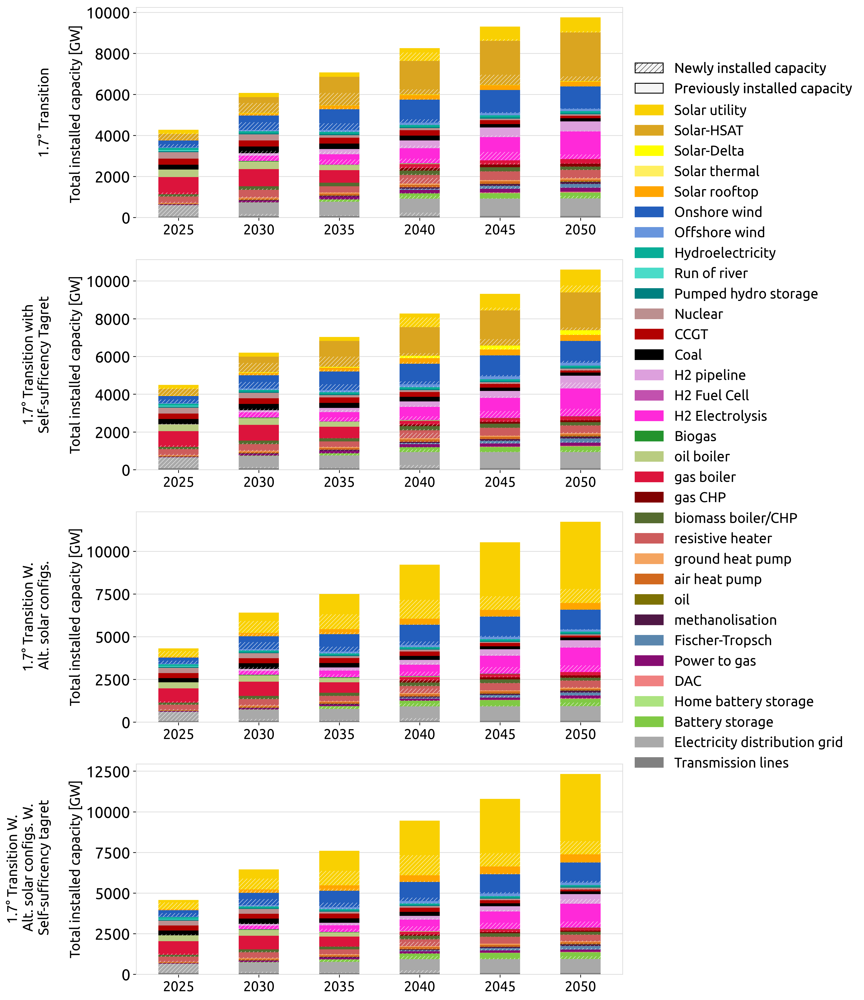

In [29]:
## Important : this figure does not include store costs
from matplotlib.patches import FancyArrowPatch
import matplotlib.font_manager
import matplotlib.lines as lines

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['hatch.linewidth'] = 0.4
plt.rcParams['hatch.color'] = 'white'
#plt.rcParams['figure.dpi'] = 1000

def add_arrow(ax0, ax1, pos0, pos1, **arrow_kwargs):
    ax0tr = ax0.transData  # Axis 0 -> Display
    ax1tr = ax1.transData  # Axis 1 -> Display
    figtr = fig.transFigure.inverted()  # Display -> Figure
    ptB = figtr.transform(ax0tr.transform(pos0))
    ptE = figtr.transform(ax1tr.transform(pos1))
    arrow = FancyArrowPatch(
        ptB,
        ptE,
        transform=fig.transFigure,  # Place arrow in figure coord system
        **arrow_kwargs,
    )
    fig.patches.append(arrow)
arrow_style = dict(arrowstyle="simple", mutation_scale=15, ec=None)
    
fig, axs = plt.subplots(4,1,figsize=(10,20), dpi=300) #, sharey=True)
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.5)

bar_width=0.5
index=np.arange(len(main_scen[scen][0])) 

hatches=['','////']

results_total1 = results_total1.drop(labels=['Heat storage', 'gas pipeline','co2 vent','OCGT',
        'battery discharger', 'home battery discharger'])
#                         'Total-cost','co2 vent', 'oil','gas','coal','lignite'
#                             , 'DC','uranium','process emissions','process emissions CC',
#                             'gas for industry','gas for industry CC','solid biomass for industry',
#                             'solid biomass for industry CC','V2G', 'BEV charger',
#                                            'gas pipeline' ,'gas pipeline new' ,
#                                            'gas for industry' ,'gas for industry CC',
#                                            'biomass', 'solid biomass transport','Heat storage'])

for i,base in enumerate(main_scen.keys()):
    for k, year in  enumerate(main_scen[base][0]):
            scenario=base.format(str(year))
            bottom=0
            axs[i].grid(axis = 'y',color='gainsboro', zorder=0)
            for color, component in enumerate(results_total1[scenario].index):
                
               if  component not in results_new1[scenario].index:
                  axs[i].bar(index[k], results_total1[scenario][component]/1e3
                           , bar_width, bottom=bottom,
                           color=tech_colors[component], zorder=3, )
                  bottom+=results_total1[scenario][component]/1e3
     
               else :
                  axs[i].bar(index[k], results_new1[scenario][component]/1e3
                             , bar_width, bottom=bottom,    
                           color=tech_colors[component], zorder=3, hatch='/////',# edgecolor='white', 
                            ) 
                  bottom+=results_new1[scenario][component]/1e3

                  axs[i].bar(index[k], (results_total1[scenario][component]-results_new1[scenario][component])/1e3
                           , bar_width, bottom=bottom,
                           color=tech_colors[component], zorder=3, )#hatch=hatches[j], edgecolor='white'
                  bottom+=(results_total1[scenario][component]-results_new1[scenario][component])/1e3
               #if year==2035 and 'EQ' in base : print(component, bottom) 
            
    xlabels = [i for i in main_scen[base][0]]
            #axs[i].set_xlabel("", rotation=0)
    axs[i].set_xticks((index))    
    axs[i].set_xticklabels(xlabels,fontsize=16, rotation=0,ha='center', rotation_mode='anchor')
    axs[i].tick_params(axis='y', labelsize=18)
            #axs[i][i].set_yticks(np.arange(0, 401, 100),fontsize=25) 

axs[0].set_ylabel('1.7\xb0 Transition\n\nTotal installed capacity [GW] ',fontsize=16, fontname = 'Ubuntu')
axs[1].set_ylabel('1.7\xb0 Transition with\nSelf-sufficency Tagret\n\nTotal installed capacity [GW]',fontsize=16, fontname = 'Ubuntu')
axs[2].set_ylabel('1.7\xb0 Transition W.\n Alt. solar configs.\n\nTotal installed capacity [GW]',fontsize=16, fontname = 'Ubuntu')
axs[3].set_ylabel('1.7\xb0 Transition W.\n Alt. solar configs. W.\n Self-sufficency tagret\n\nTotal installed capacity [GW]',
                  fontsize=16, fontname = 'Ubuntu')


            
legend_manual=[]
for key in (results_total1[scenario].index):
    legend_manual.append(mpatches.Patch(color=tech_colors[key], label=key))
legend1=plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1, 4.2),ncol=1,
           fontsize=16,frameon=False)
plt.gca().add_artist(legend1)


legend_manual=[]
for i, label in enumerate(['Previously installed capacity', 'Newly installed capacity']):
    legend_manual.append(mpatches.Patch(facecolor='whitesmoke', hatch=hatches[i], edgecolor='k', 
                                        label=label))
legend2=plt.legend(handles=legend_manual[::-1],loc='upper left', 
                   bbox_to_anchor=(1, 4.4),ncol=1,
           fontsize=16,frameon=False)
plt.gca().add_artist(legend2)

# Suuplementary figure 29 + Suuplementary figure 30

In [23]:

def generation(n, carriers=None):

    dispatch = n.generators_t.p 

    generation = n.snapshot_weightings.generators @ (dispatch) #n.snapshot_weightings.generators

    generation = (
        generation.groupby([n.generators.bus.map(n.buses.location), n.generators.carrier])
        .sum()
        .unstack()
    )
    
    links_gen= (-1) *n.snapshot_weightings.generators @(n.links_t.p1)
    links_gen = (links_gen.groupby([n.links.bus1.map(n.buses.location), n.links.carrier])
        .sum()
        .unstack()
    )
    for i in links_gen['nuclear'].index:
         if 'EU' not in i :  
            generation.loc[ ( i,'nuclear' ) ]=links_gen['nuclear'].loc[i]
    for i in links_gen['coal'].index:
         if 'EU' not in i :  
            generation.loc[ ( i,'coal' ) ]=links_gen['coal'].loc[i] + links_gen['lignite'].loc[i]
    for i in links_gen['OCGT'].index:
            generation.loc[ ( i, "gas" ) ]=(links_gen['OCGT'].loc[i] + links_gen['CCGT'].loc[i])# + 
           # links_gen[[i for i in links_gen.columns if 'gas boiler' in i or 'gas CHP' in i]].loc[i].sum()) 

    storage_gen= n.snapshot_weightings.generators @(n.storage_units_t.p)
    storage_gen = (storage_gen.groupby([n.storage_units.bus.map(n.buses.location), n.storage_units.carrier])
        .sum()
        .unstack()
    ).fillna(0)
    for i in storage_gen['hydro'].index:
        generation.loc[ ( i, "hydro" ) ]= storage_gen['hydro'].loc[i]
        generation.loc[ ( i, "PHS" ) ]= (-1) *storage_gen['PHS'].loc[i]

    if carriers is not None:
        generation = generation[carriers]

    return generation.drop("EU", axis=0).stack().div(1e6)  #TWh


In [24]:
def generation_regional(n, carriers=None):
    
    location = (
        pd.Series([' '.join(i.split(' ')[:2]) for i in n.generators.index], index=n.generators.index)
        ) 
        
    dispatch = n.generators_t.p 

    generation = n.snapshot_weightings.generators @ (dispatch) #n.snapshot_weightings.generators

    generation = (
        generation.groupby([generation.index.map(location) , n.generators.carrier])
        .sum()
        .unstack()
    )
    # links are not regional
    #links_gen= (-1) *n.snapshot_weightings.generators @(n.links_t.p1)
    #links_gen = (links_gen.groupby([n.links.bus1.map(n.buses.location), n.links.carrier])
    #    .sum()
    #    .unstack()
    #)
    #for i in links_gen['nuclear'].index:
    #  if 'EU' not in i :  
    #        generation.loc[ ( i, "nuclear" ) ]=links_gen['nuclear'].loc[i]
    #for i in links_gen['OCGT'].index:
    #        generation.loc[ ( i, "gas" ) ]=links_gen['OCGT'].loc[i] + links_gen['CCGT'].loc[i]        

    if carriers is not None:
        generation = generation[carriers]

    return generation.stack().div(1e6)  #TWh


In [48]:
##### 2-Hr resolution - Base case

##ATTENTION : for some reason the leggend circles are not the correct size when more than one row
## is in the figure : so the legend is produced with a single row figure and attached to the figure
## 2025 only, figsize=(10,5) 
main_scen={
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2040,2050],'Base']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2040,2050],'Base w. Self-suff.']  ,

}


carriers = {
        "offwind-ac": "Offshore Wind (AC)",
        "offwind-dc": "Offshore Wind (DC)",
        "onwind": "Onshore Wind",
        "ror": "Run of River",
        "solar rooftop": "Rooftop Solar PV",
        "solar": "Utility Solar PV",
        "nuclear" : 'Nuclear',
        "gas" : 'OCGT/CCGT', #'gas to power/heat',
        "coal" : 'Coal',
        "PHS" : 'Pumped hydro storage',
        "hydro" : 'Hydroelectricity'
    }

import cartopy.crs as ccrs
import cartopy
import geopandas as gpd

epsg = 3035
nodes = gpd.read_file('resources/regions_onshore_elec_s370_37m.geojson').set_index("name")
nodes["Area"] = nodes.to_crs(epsg=epsg).area.div(1e6)
#fig,axs = plt.subplots(len(main_scen[scen][0]),len(main_scen.keys()), figsize=(10,20) , subplot_kw={"projection":ccrs.PlateCarree()})   #or  ccrs.Orthographic() .Mercator
fig,axs = plt.subplots(4,len(main_scen.keys()), figsize=(10,20) , subplot_kw={"projection":ccrs.PlateCarree()})   #or  ccrs.Orthographic() .Mercator
fig.subplots_adjust(hspace=-0.3)

for j,base in enumerate(main_scen.keys()):
    for i, year in  enumerate(main_scen[base][0]):   ##chnage to only 2025 for getting the legend
            scenario=base.format(str(year))
            n=pypsa.Network(scenario)
            loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)
            gen = generation(n, carriers.keys())

            line_width_factor=10
            bus_size_factor=200

            n.plot (ax=axs[i,j],
               bus_colors=tech_colors,
               branch_components=["Line"],
               line_widths=n.lines.s_nom_opt/(1e3*line_width_factor),  #GW
               line_colors='k',
               geomap=True,
               bus_sizes=gen/(bus_size_factor))  #TWh

            axs[i,j].axis('off')
            axs[i,j].set_extent([-10.53, 28.8, 35, 70])
            if i==0 :
              axs[i,j].set_title(main_scen[base][1]+' '+str(year), fontsize=16)
            """
              if j==0:  
                sizes = [50, 100]
                labels = [f"{s} TWh" for s in sizes]
                add_legend_circles(
                axs[i,j],
                sizes,
                labels,
                scale=bus_size_factor,
                srid=n.srid,
                legend_kw=dict(title="Energy generation", loc="upper left",fontsize=6, frameon=False),
                patch_kw=dict(facecolor="lightgrey",),
                )

                sizes = [10, 20]
                labels = [f"{s} GW" for s in sizes]
                add_legend_lines(
                axs[i,j],
                sizes,
                labels,
                scale=line_width_factor ,
                legend_kw=dict(title="Line Capacity", bbox_to_anchor=(0.285, 0.85),fontsize=6,frameon=False),
                patch_kw=dict(color="lightgrey"),
                )
            """
            
            if i!=0 :
                axs[i,j].set_title(str(year), fontsize=16, y=0.9)



colors = [tech_colors[c] for c in carriers.keys()]
labels=[carriers[i] for i in carriers.keys()]
add_legend_patch(
        axs[i,j],
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(bbox_to_anchor=(1.1,-0.5), ncol=1,fontsize=14,frameon=False),)

/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


In [ ]:
##### 2-Hr resolution - Base case -nodal

##ATTENTION : for some reason the leggend circles are not the correct size when more than one row
## is in the figure : so the legend is produced with a single row figure and attached to the figure
plt.rcParams['figure.dpi'] = 300


main_scen={
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2040,2050],'Alt. Solar']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2040,2050],'Alt. Solar W. Self-suff.']  ,

}



carriers = {
        "offwind-ac": "Offshore Wind (AC)",
        "offwind-dc": "Offshore Wind (DC)",
        "onwind": "Onshore Wind",
        "ror": "Run of River",
        "solar rooftop": "Rooftop Solar PV",
        "solar-inv-1.5": "Utility Solar PV",
        "solar-inv-1.7": "Utility Solar PV",
        "solar": "Utility Solar PV",
        "solar-hsat": "Solar-HSAT",
        "solar-hsat-inv-1.3":  "Solar-HSAT",
        "solar-hsat-inv-1.5":  "Solar-HSAT",
        "solar-delta": "Solar-Delta",
        "nuclear" : 'Nuclear',
        "gas" : 'OCGT/CCGT', #'gas to power/heat',
        "coal" : 'Coal',
        "PHS" : 'Pumped hydro storage',
        "hydro" : 'Hydroelectricity'    }

tech_colors_map= {}

for carrier in carriers.keys():
    if 'solar' not in carrier:
      tech_colors_map[carrier]= tech_colors[carrier] 
    
    elif 'solar rooftop' not in carrier :
      if 'hsat' in carrier:
        tech_colors_map[carrier] =  tech_colors['Solar-HSAT'] 
      elif 'delta' in carrier:
        tech_colors_map[carrier] =  tech_colors['Solar-Delta'] 
      else  :
         tech_colors_map[carrier] =  tech_colors['solar'] 

    else :
      tech_colors_map[carrier] =  tech_colors['solar rooftop'] 

    
import cartopy.crs as ccrs
import cartopy
import geopandas as gpd

epsg = 3035
nodes = gpd.read_file('resources/regions_onshore_elec_s370_37m.geojson').set_index("name")
nodes["Area"] = nodes.to_crs(epsg=epsg).area.div(1e6)
#fig,axs = plt.subplots(len(main_scen[scen][0]),len(main_scen.keys()), figsize=(10,20) , subplot_kw={"projection":ccrs.PlateCarree()})   #or  ccrs.Orthographic() .Mercator
fig,axs = plt.subplots(4,len(main_scen.keys()), figsize=(10,20) , subplot_kw={"projection":ccrs.PlateCarree()})   #or  ccrs.Orthographic() .Mercator
fig.subplots_adjust(hspace=-0.3)

for j,base in enumerate(main_scen.keys()):
    for i, year in  enumerate(main_scen[base][0]):
            scenario=base.format(str(year))
            n=pypsa.Network(scenario)
            loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)
            gen = generation(n, carriers.keys())

            line_width_factor=10
            bus_size_factor=200

            n.plot (ax=axs[i,j],
               bus_colors=tech_colors_map,
               branch_components=["Line"],
               line_widths=n.lines.s_nom_opt/(1e3*line_width_factor),  #GW
               line_colors='k',
               geomap=True,
               bus_sizes=gen/(bus_size_factor))  #GWh

            axs[i,j].axis('off')
            axs[i,j].set_extent([-10.53, 28.8, 35, 70])
            if i==0 :
              axs[i,j].set_title(main_scen[base][1]+' '+str(year), fontsize=16)

              if j==0:  
                sizes = [25, 50]
                labels = [f"{s} TWh" for s in sizes]
                add_legend_circles(
                axs[i,j],
                sizes,
                labels,
                scale=bus_size_factor,
                srid=n.srid,
                legend_kw=dict(title="Energy generation", loc="upper left",fontsize=6, frameon=False),
                patch_kw=dict(facecolor="lightgrey",),
                )

                sizes = [10, 20]
                labels = [f"{s} GW" for s in sizes]
                add_legend_lines(
                axs[i,j],
                sizes,
                labels,
                scale=line_width_factor ,
                legend_kw=dict(title="Line Capacity", bbox_to_anchor=(0.285, 0.85),fontsize=6,frameon=False),
                patch_kw=dict(color="lightgrey"),
                )
            
            if i!=0 :
                axs[i,j].set_title(str(year), fontsize=16, y=0.9)


labels=[carriers[i] for i in carriers.keys() if 'inv' not in i]
colors = [tech_colors_map[c] for c in carriers.keys() if 'inv' not in c]

add_legend_patch(
        axs[i,j],
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(bbox_to_anchor=(1.1,-0.5), ncol=1,fontsize=14,frameon=False),)

# Figure 4

In [32]:
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"solid"})

4960866.1007839525
5320533.952802908


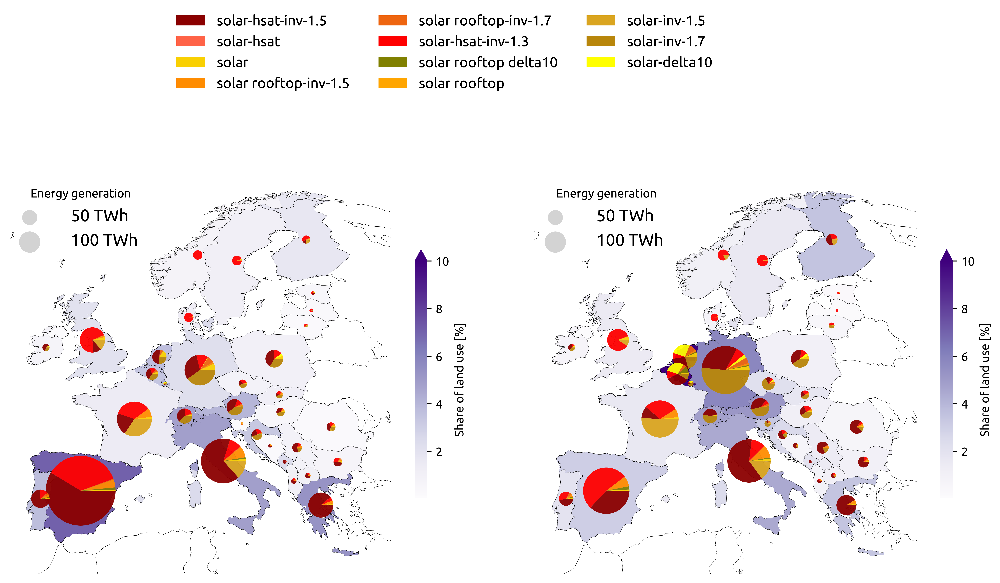

In [44]:
## generation map

## installed capacity map

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
proj = ccrs.EqualEarth() #PlateCarree() #

fig,axs = plt.subplots(1,2,figsize=(15,7.5) , subplot_kw={"projection": proj}, dpi=600)   #or  ccrs.Orthographic() .Mercator
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='None')
fig.subplots_adjust(wspace=0.1)

## initial solar max capacity (this gets reduced every investment period based on previously installed)
n_2025 = pypsa.Network('myopic_runs/prenetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc')
# Base 2050 : Use these networks to produce figure 4.a
#n1=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc')
#n2=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2050.nc')
## new solar -2050 : Use these networks to produce Figure 4.b and 4.c
n1=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc')
n2=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc')

land_use_factors= {
        'solar-delta' : 0.78  ,                                                                     
        'solar-hsat'  : 1.15 ,                                                                      
        }
bus_size_factor= 200

for c, n in enumerate([n1, n2]):
     
     geodf = gpd.read_file('resources//regions_onshore_elec_s370_37m.geojson').set_index("name")  #for country-wise
     geodf = geodf.to_crs(proj.proj4_init)
     geodf.boundary.plot(ax=axs[c],zorder=1,edgecolor='black', linewidth= 0.1) 

     solar = [i for i in n.generators.index if 'solar' in i
                      and 'thermal' not in i and 'rooftop' not in i]#.groupby(n.generators.bus).sum()

     land_use = pd.DataFrame(1, index=solar, columns=['land_use_factor'])
     for key in land_use_factors.keys():
        land_use = land_use.apply(lambda x: (x*land_use_factors[key]) if key in x.name else x,  axis=1)

     dc_capacity = pd.DataFrame(1, index=solar, columns=['dc_capacity'])
     dc_capacity = dc_capacity.apply(lambda x: (x* float(x.name[x.name.find('inv-')+4:x.name.find('inv-')+7])) if 
                                'inv' in x.name else x,  axis=1)  
     location = (           ##for nodal
        pd.Series([' '.join(i.split(' ')[:2]) for i in n.generators.index], index=n.generators.index)
        )
     ggrouper= pd.Series( n.generators.loc[solar].index.rename('bus').map(location), index=n.generators.loc[solar].index,)
     
     #installed= pd.DataFrame((n.generators.p_nom_opt.loc[solar].values*land_use.squeeze().values*
     #                    dc_capacity.squeeze()).groupby(ggrouper).sum()).squeeze()   ##for nodal

     installed= pd.DataFrame((n.generators.p_nom_opt.loc[solar]*land_use.squeeze().values*dc_capacity.squeeze().values)
                             .groupby(n.generators.bus).sum()).squeeze()
        
     ## the p_nom_max for 2025 (prenetwork so initial brownfiled is not excluded)
     #installed =(installed/n_2025.generators.p_nom_max[n_2025.generators.carrier=='solar'].values).
        # reindex(geodf.index).fillna(0)  ##for nodeal
     print(installed.sum())   
        
     installed =(installed/n_2025.generators.p_nom_max[n_2025.generators.carrier=='solar'].
         groupby(n_2025.generators.bus).sum().values).reindex(geodf.index).fillna(0)
    
     geodf.plot(
        ax=axs[c],
        column=installed*10,
#        # transform=ccrs.PlateCarree(),
        cmap="Purples",
        alpha=1,
        linewidths=0,
        vmax=10,
        legend=True,
        legend_kwds={"label": 'Share of land use [%]',
                     "shrink": 0.5, "extend": "max"},
     )  
     
     axs[c].add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
     axs[c].add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)
    
     geodf = gpd.read_file('resources/regions_onshore_elec_s370_37m.geojson').set_index("name")
     geodf = geodf.to_crs(proj.proj4_init)
     centroids = geodf.centroid
     solar=[i for i in n.generators.index if 'solar' in i and 'thermal' not in i]

     tech = ( pd.Series(['-'.join(' '.join(i.split(' ')[2:]).split('-')[:-1]) for i in 
          n.generators.loc[solar].index], index=n.generators.loc[solar].index))

     location = (pd.Series([i[:2] for i in n.generators.index], index=n.generators.index)) 

     ggrouper= pd.Series(n.generators.loc[solar].index.map(tech), 
                             index=n.generators.loc[solar].index,)

     shares= n.generators_t.p.loc[:,solar].sum().groupby([location, ggrouper]).sum()/1e6 #TWh

     for i, country in enumerate(set(shares.index.get_level_values(0))):
         node= [k for k in geodf.index if country in k][0] ##first element for countries with 2 nodes
         x_coord = centroids.loc[node].x
         y_coord = centroids.loc[node].y
         ax_sub = inset_axes(axs[c], width=0.4, height=0.4, loc=10, bbox_to_anchor=(x_coord, y_coord),
                        bbox_transform=axs[c].transData)
         ax_sub.pie(shares[country], 
               radius= ((shares[country].sum()/bus_size_factor)**.5),
               wedgeprops={'linewidth': 0,"alpha": 0.95}, colors=[tech_colors[carrier] for carrier in shares[country].index])


#axs[0].set_title('Alt. solar'+' '+str(2025), fontsize=16)

#axs[1].set_title('Alt. solar with Self-suff.'+' '+str(2025), fontsize=16)


sizes = [50, 100]
labels = [f"{s} TWh" for s in sizes]
for ax in axs.flat: 
   add_legend_circles(
             ax,
             sizes,
             labels,
             scale=bus_size_factor/3.14,
             srid=n.srid,
             legend_kw=dict(title="Energy generation", loc="upper left",
                            bbox_to_anchor=(0, 1), fontsize=14, frameon=False),
             patch_kw=dict(facecolor="lightgrey",),
              )


labels= set(shares.index.get_level_values(1))
colors = [tech_colors[c] for c in labels]

add_legend_patch(
        axs[1],
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(loc='right',bbox_to_anchor=(0.5, 1.3), ncol=3,fontsize=12,frameon=False),)   

## Supplementary Figure 31 

4960866.1007839525
5320533.952802908


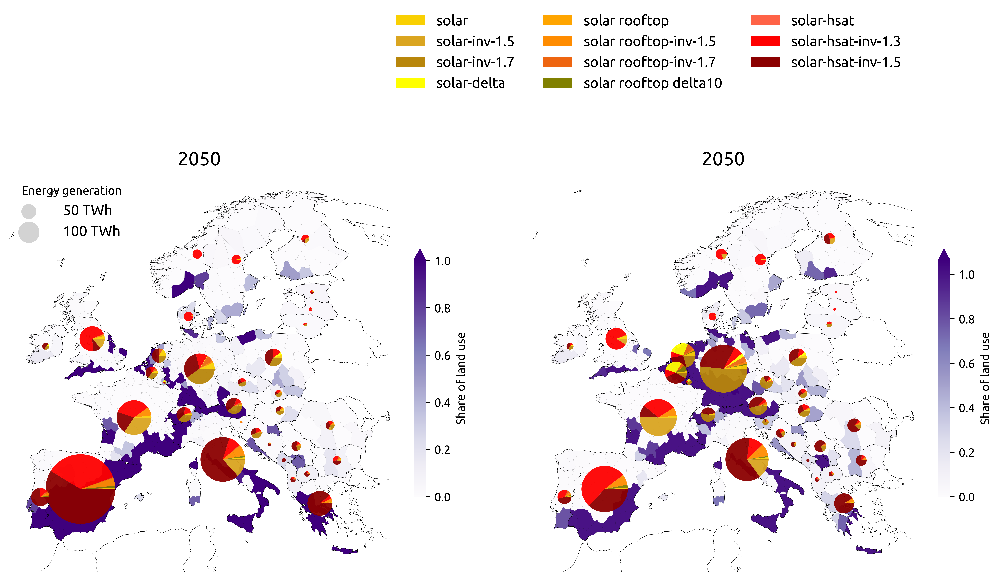

In [45]:
## generation map

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
proj = ccrs.EqualEarth() #PlateCarree() #
plt.rcParams['figure.dpi'] = 600



fig,axs = plt.subplots(1,2,figsize=(15,7.5) , subplot_kw={"projection": proj}, dpi=600)   #or  ccrs.Orthographic() .Mercator
plt.rc('font',family='Ubuntu')  
plt.rc('axes',edgecolor='None')
fig.subplots_adjust(wspace=0.1)

## initial solar max capacity (this gets reduced every investment period based on previously installed)
n_2025 = pypsa.Network('myopic_runs/prenetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc')
## new solar -2050 (change year to get all subfigures)
n_1='myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc'
n_2='myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc'

land_use_factors= {
        'solar-delta' : 0.78  ,                                                                     
        'solar-hsat'  : 1.15 ,                                                                      
        }



for k, year in enumerate([2050]) : #,2030,2040]):
  for c, n_base in enumerate([n_1, n_2]):  
     n=pypsa.Network(n_base.format(str(year)))

    
     geodf = gpd.read_file('resources/regions_onshore_elec_s370.geojson').set_index("name")
     geodf = geodf.to_crs(proj.proj4_init)
     geodf.boundary.plot(ax=axs[c],zorder=1,edgecolor='black', linewidth= 0.1) 

     solar = [i for i in n.generators.index if 'solar' in i
                      and 'thermal' not in i and 'rooftop' not in i]#.groupby(n.generators.bus).sum()

     land_use = pd.DataFrame(1, index=solar, columns=['land_use_factor'])
     for key in land_use_factors.keys():
        land_use = land_use.apply(lambda x: (x*land_use_factors[key]) if key in x.name else x,  axis=1)

     dc_capacity = pd.DataFrame(1, index=solar, columns=['dc_capacity'])
     dc_capacity = dc_capacity.apply(lambda x: (x* float(x.name[x.name.find('inv-')+4:x.name.find('inv-')+7])) if 
                                'inv' in x.name else x,  axis=1)  
     location = (
        pd.Series([' '.join(i.split(' ')[:2]) for i in n.generators.index], index=n.generators.index)
        )
     ggrouper= pd.Series(n.generators.loc[solar].index.rename('bus').map(location), index=n.generators.loc[solar].index,)
     installed= pd.DataFrame((n.generators.p_nom_opt.loc[solar].values*land_use.squeeze().values*
                         dc_capacity.squeeze()).groupby(ggrouper).sum()).squeeze()

     print(installed.sum())
     ## the p_nom_max for 2025 (prenetwork so initial brownfiled is not excluded)
     installed =(installed/n_2025.generators.p_nom_max[n_2025.generators.carrier=='solar'].values).reindex(geodf.index).fillna(0)
     geodf.plot(
        ax=axs[c],
        column=installed,
        # transform=ccrs.PlateCarree(),
        cmap="Purples",
        alpha=1,
        linewidths=0,
        #vmax=s.max(),
        legend=True,
        legend_kwds={"label": 'Share of land use',
                     "shrink": 0.5, "extend": "max"},
     )  
     
     axs[c].add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
     axs[c].add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)
    
     geodf = gpd.read_file('resources/regions_onshore_elec_s370_37m.geojson').set_index("name")
     geodf = geodf.to_crs(proj.proj4_init)
     centroids = geodf.centroid
     solar=[i for i in n.generators.index if 'solar' in i and 'thermal' not in i]

     tech = ( pd.Series(['-'.join(' '.join(i.split(' ')[2:]).split('-')[:-1]) for i in 
          n.generators.loc[solar].index], index=n.generators.loc[solar].index))

     location = (pd.Series([i[:2] for i in n.generators.index], index=n.generators.index)) 

     ggrouper= pd.Series(n.generators.loc[solar].index.map(tech), 
                             index=n.generators.loc[solar].index,)

     shares= n.generators_t.p.loc[:,solar].sum().groupby([location, ggrouper]).sum()/1e6 #TWh
     #print(shares.filter(like='PT').sum()) 
     for i, country in enumerate(set(shares.index.get_level_values(0))):
         node= [k for k in geodf.index if country in k][0] ##first element for countries with 2 nodes
         x_coord = centroids.loc[node].x
         y_coord = centroids.loc[node].y
         ax_sub = inset_axes(axs[c], width=0.4, height=0.4, loc=10, bbox_to_anchor=(x_coord, y_coord),
                        bbox_transform=axs[c].transData)
         ax_sub.pie(shares[country], 
               radius= ((shares[country].sum()/bus_size_factor)**.5),
               wedgeprops={'linewidth': 0,"alpha": 0.95}, colors=[tech_colors[carrier] for carrier in shares[country].index])

  if year==2025:
        axs[0].set_title('Alt. solar'+' '+str(year), fontsize=16)
        axs[1].set_title('Alt. solar with Self-suff.'+' '+str(year), fontsize=16)  

  else:
        axs[0].set_title(str(year), fontsize=16)
        axs[1].set_title(str(year), fontsize=16)  

sizes = [50, 100]
labels = [f"{s} TWh" for s in sizes]
add_legend_circles(
             axs[0],
             sizes,
             labels,
             scale=bus_size_factor/3.14, 
             srid=n.srid,
             legend_kw=dict(title="Energy generation", loc="upper left",
                            bbox_to_anchor=(0, 1), fontsize=12, frameon=False),
             patch_kw=dict(facecolor="lightgrey",),
              )


#labels= set(shares.index.get_level_values(1))
labels = ['solar',
 'solar-inv-1.5',
 'solar-inv-1.7',
 'solar-delta',
 'solar rooftop',
 'solar rooftop-inv-1.5',
 'solar rooftop-inv-1.7',
 'solar rooftop delta10',
 'solar-hsat',
 'solar-hsat-inv-1.3',
 'solar-hsat-inv-1.5',
         ]
colors = [tech_colors[c] for c in labels]

add_legend_patch(
        axs[c],
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(loc='right',bbox_to_anchor=(1, 1.3), ncol=3,fontsize=12,frameon=False),)   

In [ ]:
## average solar land-use
#print(installed-mean())
print(4960866.1007839525 /n_2025.generators.p_nom_max[n_2025.generators.carrier=='solar'].values.sum() )
print(5320533.952802908 / n_2025.generators.p_nom_max[n_2025.generators.carrier=='solar'].values.sum() )
#(23% of the 10% suitable land : 2.3% of suitable land)
#(25% of the 10% suitable land : 2.5% of suitable land)

In [3]:
## average wind land use
import pypsa
n_2025 = pypsa.Network('myopic_runs/prenetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc')
# Base 2050
#n_1='myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_{}.nc'
#n_2='myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_{}.nc'
## new solar -2050
n_1=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc')
n_2=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc')


temp1= n_1.generators.p_nom_opt.filter(like='onwind').sum()/(n_2025.generators.p_nom_max.filter(like='onwind').sum()+181637.15000000002)
temp2= n_2.generators.p_nom_opt.filter(like='onwind').sum()/(n_2025.generators.p_nom_max.filter(like='onwind').sum()+181637.15000000002)
#(0.13% of 30% suitable land is 3.9% of suitable land)

print(temp1)
print(temp2)

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


0.12200307306877507
0.12996594100987557


## Figure 5 + Figure 6 + Supplementary Figure 22 + Supplementary Figure 23 + Supplementary Figure 24 + Supplementary Figure 25 + Supplementary Figure 26 + Supplementary Figure 27

In [7]:
##For IRENA:
df_historical_IRENA = pd.read_excel('data/ELECSTAT_20240814-082637.xlsx', #'data/RECAP_20240205-091627.xlsx', 
                   header=[2], 
                   index_col=[0,1], 
                   )

df_historical_IRENA.columns=[int(i) for i in df_historical_IRENA.columns]
df_historical_IRENA= df_historical_IRENA.replace('-', 0)

In [8]:

##For IRENA, generation:
df_historicalgen_IRENA = pd.read_excel('data/ELECSTAT_20240822-104238.xlsx', #'data/RECAP_20240205-091627.xlsx', 
                   header=[2], 
                   index_col=[0,1], 
                   )

df_historicalgen_IRENA.columns=[int(i) for i in df_historicalgen_IRENA.columns]
df_historicalgen_IRENA= df_historicalgen_IRENA.replace('-', 0)
df_historicalgen_IRENA= df_historicalgen_IRENA.drop(columns=[2023])  ##not available as of August 2024

In [9]:
##For IRENA, supply:
df_supply_IRENA = pd.read_excel('data/ELECSTAT_supply.xlsx', #'data/RECAP_20240205-091627.xlsx', 
                   header=[2], 
                   index_col=[0,1], 
                   )

df_supply_IRENA.columns=[int(i) for i in df_supply_IRENA.columns]
df_supply_IRENA= df_supply_IRENA.replace('-', 0)
df_supply_IRENA= df_supply_IRENA.drop(columns=[2023])  ##not available as of August 2024

In [10]:
df_historical_IRENA=df_historical_IRENA.sort_index()  
df_historicalgen_IRENA= df_historicalgen_IRENA.sort_index() 
df_historical_IRENA=df_historical_IRENA.sort_index()  
df_supply_IRENA= df_supply_IRENA.sort_index() 

In [12]:
## RUN for IRENA plots

iso2name={'AT':'Austria',
          'BE':'Belgium',
          'BG':'Bulgaria',
          'CH':'Switzerland',
          'CZ':'Czechia',
          'DE':'Germany',
          'DK':'Denmark',
          'EE':'Estonia',
          'ES':'Spain',
          'FI':'Finland',
          'FR':'France',
          'GB':'United Kingdom',
          'GR':'Greece',
          'HR':'Croatia',
          'HU':'Hungary',
          'IT':'Italy',
          'LT':'Lithuania',
          'LU':'Luxembourg',
          'LV':'Latvia',
          'NO':'Norway',
          'PL':'Poland',
          'PT':'Portugal',
          'RO':'Romania',
          'SE':'Sweden',
          'SI':'Slovenia',
          'SK':'Slovakia',
          'IE':'Ireland',
          'NL':'Netherlands',
          'ME':'Montenegro',
          'AL':'Albania',
          'BA':'Bosnia and Herzegovina',
          'MK':'North Macedonia',
          'RS':'Serbia',}

name2iso = {v: k for k, v in iso2name.items()}

location = (
        n.buses.location
        if "location" in n.buses.columns
        else pd.Series(n.buses.index, index=n.buses.index)
    )

In [11]:
n=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc')


INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [13]:
## transitions : DC capacity for solar / for AC capacity disable mentioned line

main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'Base']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'Base w Equity']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar w Equity']  ,

}

countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])
years= [2025, 2030,2035, 2040, 2045, 2050]
scenario =main_scen.keys()

iterables = [["Base","Base w Equity","New-Solar", "New-Solar w Equity"], countries, years]
technologies=['solar','onwind','offwind-ac','offwind-dc']

df_capacities= pd.DataFrame(index=pd.MultiIndex.from_product(iterables, names=["scenario","bus", "year"]), columns=technologies)   ##cost to energy ratios
df_generation= pd.DataFrame(index=pd.MultiIndex.from_product(iterables, names=["scenario","bus", "year"]), columns=technologies)   ##cost to energy ratios

ggrouper = n.generators.bus.map(location).map(n.buses.country)


for j, scenario in enumerate(main_scen.keys()):
   for y, year in enumerate(main_scen[scenario][0]): 
         n=pypsa.Network(scenario.format(year)) 
         for tech in technologies:
             idx=[i for i in n.generators.index if tech in n.generators.carrier[i] and 'thermal'
                          not in n.generators.carrier[i] ]     ##for solar
            
             dc_capacity = pd.DataFrame(1, index=idx, columns=['dc_capacity'])
             dc_capacity = dc_capacity.apply(lambda x: (x* float(x.name[x.name.find('inv-')+4:x.name.find('inv-')+7])) if 
                                'inv' in x.name else x,  axis=1)  ##disable for AC capacity
            
             for country in countries:  
                df_generation.loc[main_scen[scenario][1],country, year][tech] = (
                       n.generators_t.p.loc[:,idx].filter(like=country).sum().sum()) /1e3 ##GWh, same as IRENA
                
                if year==2025: 

                   df_capacities.loc[main_scen[scenario][1],country, year][tech] = (
                             (n.generators.p_nom_opt.loc[idx]*dc_capacity.squeeze()).filter(like=country).sum())
               
                   
                else  :      
                     df_capacities.loc[main_scen[scenario][1],country, (year)][tech] = (
                      df_capacities.loc[main_scen[scenario][1], country, (main_scen[scenario][0][y-1])][tech]+
                      ((n.generators.p_nom_opt.loc[idx]*dc_capacity.squeeze()).
                       filter(like=country).filter(like=str(year)).sum()))
    


INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2035.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2040.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2045.nc has buses, carriers, generators, global_constraints, lines, links, load

In [45]:
plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})

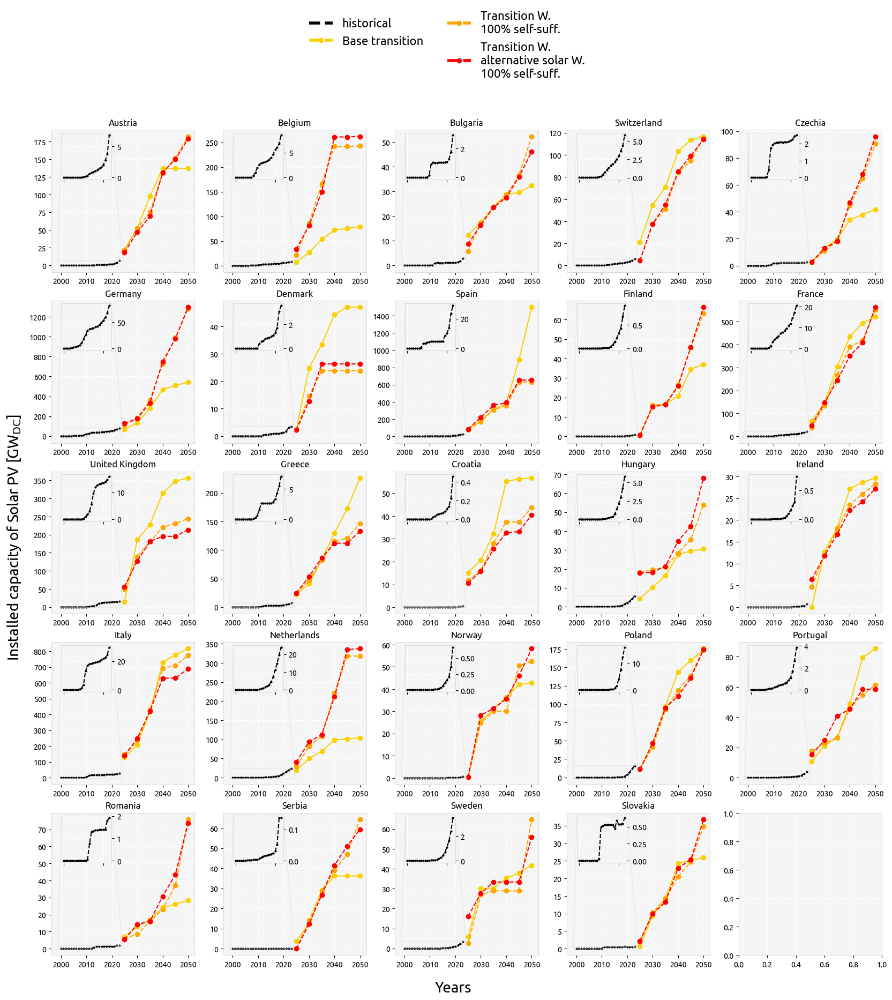

In [50]:
## Figure S22 : cumulative installed capacity with IRENA :DC
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})
                     
fig, axs = plt.subplots(5,5, figsize=(20,20)) 
#fig.subplots_adjust(hspace=0.3)
count2=0   
  
    
for count,country in enumerate(sorted(countries)):   
  if  df_capacities.loc['New-Solar w Equity',country,:]['solar'].values.max()/1e3 > 20:
  
    i= int(count2/5)
    j=count2%5
    axs[i,j].plot(years  ,
                df_capacities.loc['Base',country,:]['solar'].values/1e3 ,
                color=tech_colors['solar'],
                linestyle='-',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
                df_capacities.loc['Base w Equity',country,:]['solar'].values/1e3 ,
                color='orange',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
                df_capacities.loc['New-Solar w Equity',country,:]['solar'].values/1e3 ,
                color='red',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
            axs[i,j].plot( df_historical_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze()/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    count2+=1     
    axins = axs[i,j].inset_axes([0.07, 0.65, 0.35, 0.33],xticklabels=[])
    #xlim=(0, x2), ylim=(0, y2), xticklabels=[], yticklabels=[])
    axins.plot( df_historical_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze()/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )  
    #yticks_def = axins.get_yticks() 
    #axins.set_yticks([i for i in yticks_def if i>0],va='top')
    #axins.set_yticklabels(['   '+str(i) for i in axins.get_yticks()],  horizontalalignment = "left",)# va='top', )
    #axins.tick_params(axis="y",direction="in", pad=-22)
    axins.yaxis.tick_right()

    axs[i,j].indicate_inset_zoom(axins, edgecolor="gainsboro") 
    
    axs[i][j].set_title(iso2name[country])

fig.text(0.5, 0.08, 'Years', ha='center', va='center', fontsize=20)
fig.text(0.09, 0.5, 'Installed capacity of Solar PV [GW$_\mathrm{DC}$]', ha='center', va='center', rotation='vertical',fontsize=20)


custom_lines = [Line2D([0], [0], color='k', linestyle='--', linewidth= 4),
                Line2D([0], [0], color=tech_colors['solar'], linestyle='--',  marker='o', linewidth= 4 ),
                Line2D([0], [0], color='orange',linestyle='--', marker='o', linewidth= 4 ),
                Line2D([0], [0], color='red',linestyle='--', marker='o', linewidth= 4 )]

plt.legend(custom_lines, ['historical', 'Base transition' , 'Transition W.\n100% self-suff.',
                         'Transition W.\nalternative solar W.\n100% self-suff.'],loc='center right',
           bbox_to_anchor=(-1, 6.4),ncol=2,
           fontsize=16, frameon=False) 

plt.show()        

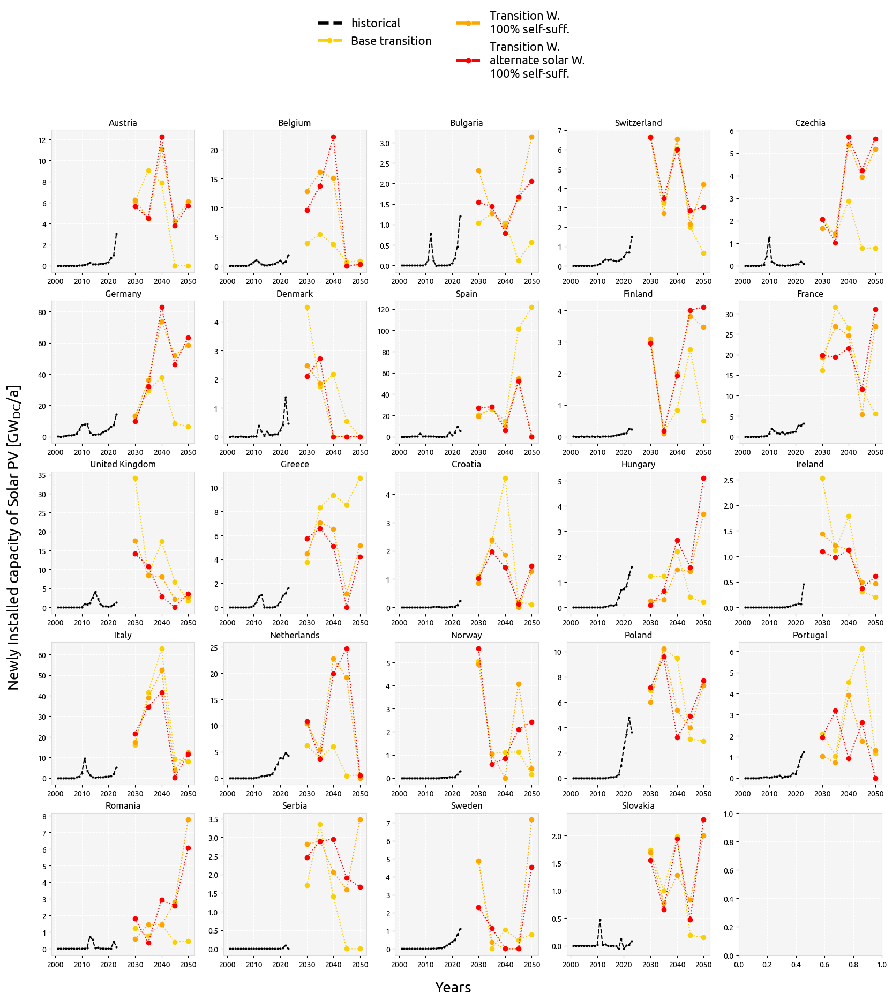

In [52]:
## Figure S23: ramp up rates with IRENA : DC
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})
                     
fig, axs = plt.subplots(5,5, figsize=(20,20)) 
#fig.subplots_adjust(hspace=0.3)
count2=0   
  
    
for count,country in enumerate(sorted(countries)):   
  if  df_capacities.loc['New-Solar w Equity',country,:]['solar'].values.max()/1e3 > 20:
  
    i= int(count2/5)
    j=count2%5
    axs[i,j].plot(years  ,
                df_capacities.loc['Base',country,:]['solar'].diff().values/5/1e3 , #.pct_change()*100, #
                color=tech_colors['solar'],
                linestyle=':',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
                df_capacities.loc['Base w Equity',country,:]['solar'].diff().values/5/1e3 , #.pct_change()*100, #
                color='orange',
                linestyle=':',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
                df_capacities.loc['New-Solar w Equity',country,:]['solar'].diff().values/5/1e3 , #.pct_change()*100, #
                color='red',
                linestyle=':',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
            axs[i,j].plot( df_historical_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze().diff()/1e3 , #.pct_change()*100, #
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    count2+=1     

    
    axs[i][j].set_title(iso2name[country])

fig.text(0.5, 0.08, 'Years', ha='center', va='center', fontsize=20)
fig.text(0.09, 0.5, 'Newly Installed capacity of Solar PV [GW$_\mathrm{DC}$/a]', ha='center', va='center', rotation='vertical',fontsize=20)


custom_lines = [Line2D([0], [0], color='k', linestyle='--', linewidth= 4),
                Line2D([0], [0], color=tech_colors['solar'], linestyle='--',  marker='o', linewidth= 4 ),
                Line2D([0], [0], color='orange',linestyle='--', marker='o', linewidth= 4 ),
                Line2D([0], [0], color='red',linestyle='--', marker='o', linewidth= 4 )]

plt.legend(custom_lines, ['historical', 'Base transition' , 'Transition W.\n100% self-suff.',
                         'Transition W.\nalternate solar W.\n100% self-suff.'],loc='center right',
           bbox_to_anchor=(-1, 6.4),ncol=2,
           fontsize=16, frameon=False) 

plt.show()        

/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:196: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:199: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)
/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/scipy/stats/_stats_mstats_common.py:196: RuntimeWarning: invalid

Text(0.09, 0.5, 'Share of solar PV production from electricity supply [%]')

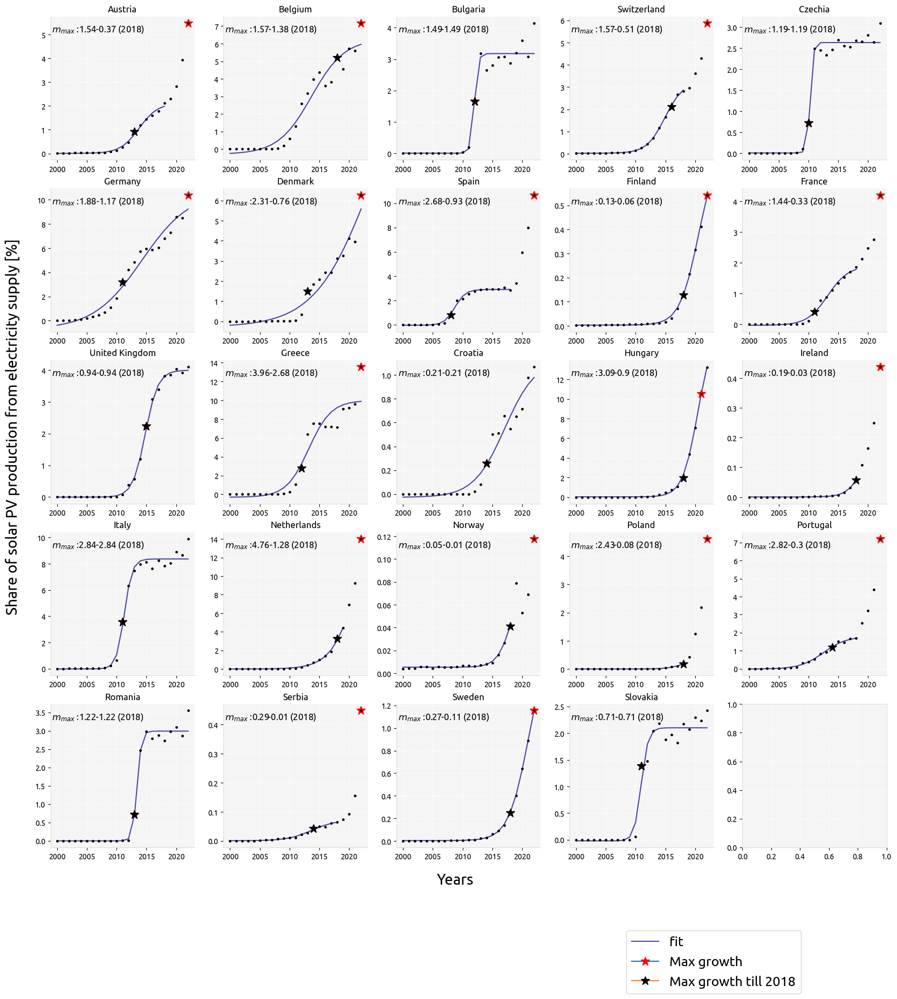

In [20]:
## Figure S26
from scipy.optimize import curve_fit
from scipy.stats import linregress



def sigmoid(x, L ,x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return (y)

fig, axs = plt.subplots(5,5, figsize=(20,20), )
count2=0

for count,country in enumerate(sorted(countries)):   
  if  df_capacities.loc['New-Solar w Equity',country,:]['solar'].values.max()/1e3 > 20:
    i= int(count2/5)
    j=count2%5
    
    data_all = (df_historicalgen_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze()*1e2/  ## 1e2 to percentage
             df_supply_IRENA.loc[iso2name[country],:].sum().squeeze())
    if country == 'NL':
        data_2018 = (df_historicalgen_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze().loc[2000:2019]*1e2/  ## 1e2 to percentage
             df_supply_IRENA.loc[iso2name[country],:].sum().squeeze().loc[2000:2019])
    else:    
      data_2018 = (df_historicalgen_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze().loc[2000:2018]*1e2/  ## 1e2 to percentage
             df_supply_IRENA.loc[iso2name[country],:].sum().squeeze().loc[2000:2018])
        
    year0=data_all.index[0]
    ydata= data_all.values
    xdata= np.arange(len(ydata))
    
    ydata_2018= data_2018.values
    xdata_2018= np.arange(len(ydata_2018))
    
    max_slope= np.gradient(ydata).max()
    max_slope_2018= np.gradient(ydata_2018).max()
    
    max_slope_year= data_all.index[np.gradient(data_all.values).argmax()]
    max_slope_2018_year= data_2018.index[np.gradient(data_2018.values).argmax()]

    p0 = [max(ydata), np.median(xdata),1,min(ydata)] # this is an mandatory initial guess
    p0_2018 = [max(ydata_2018), np.median(xdata_2018),1,min(ydata_2018)] # this is an mandatory initial guess
    
    try:
       popt_2018, pcov_2018 = curve_fit(sigmoid, xdata_2018, ydata_2018,p0_2018, method='lm') #method='lm')
       midpoint_2018=int(popt_2018[1])
       slope_2018, intercept, r_value, p_value, std_err = linregress(xdata_2018[midpoint_2018-1 : midpoint_2018+2], 
                                                sigmoid(xdata_2018, *popt_2018)[midpoint_2018-1 : midpoint_2018+2]) 
    except :
       slope_2018 = 'na'
        
    try:
       popt, pcov = curve_fit(sigmoid, xdata, ydata,p0, method='lm') #method='lm')
       midpoint=int(popt[1])
       slope, intercept, r_value, p_value, std_err = linregress(xdata[midpoint-1 : midpoint+2], 
                                                         sigmoid(xdata, *popt)[midpoint-1 : midpoint+2])
    
       axs[i,j].plot((data_all.index), sigmoid(xdata, *popt), color='navy', label='fit', alpha=0.7)
       
    except :
       slope = 'na'
       axs[i,j].plot((data_2018.index), sigmoid(xdata_2018, *popt_2018), color='navy', label='fit', alpha=0.7)
       
        #print('no curve fit for: '+datatype+' , '+str(iso2name[country]))
    
    axs[i,j].plot(
        max_slope_year,
        data_all[max_slope_year],
        marker="*",
        markersize=12,
        markerfacecolor="red",
        markeredgecolor="red",
        label='Max growth'
    )
    axs[i,j].plot(
        max_slope_2018_year,
        data_2018[max_slope_2018_year],
        marker="*",
        markersize=12,
        markerfacecolor="black",
        markeredgecolor="black",
        label='Max growth till 2018'
    )
    if slope!='na' : slope = str(round(slope, 2))
    if slope_2018!='na' : slope_2018 = str(round(slope_2018, 2))
    #axs[i,j].text(.01, .99,  '$\Delta$ S: '+ slope +'-'+slope_2018+' (2018)', 
    #              ha='left', va='top',transform=axs[i,j].transAxes)
    
    axs[i,j].text(.01, .95, '$m_{max}$ :'+str(round(max_slope, 2))+'-'+str(round(max_slope_2018, 2))+' (2018)',
                  ha='left', va='top',transform=axs[i,j].transAxes, fontsize = 12) 

    axs[i,j].scatter(data_all.index, ydata, marker='o' ,s=6, color='k', zorder=3)
    axs[i,j].spines[['right', 'top']].set_visible(False)
    count2+=1
    axs[i,j].set_title(iso2name[country])
    
axs[i,j].legend(
        fancybox=True, fontsize=18, loc='center',  bbox_to_anchor=(1, -0.8), facecolor="white", frameon=True
    )

fig.text(0.5, 0.08, 'Years', ha='center', va='center', fontsize=20)
fig.text(0.09, 0.5, 'Share of solar PV production from electricity supply [%]', ha='center', va='center', rotation='vertical',fontsize=20)

/tmp/ipykernel_7261/2274917781.py:14: PerformanceWarning: indexing past lexsort depth may impact performance.
  if  df_capacities.loc[('New-Solar w Equity',country),df_capacities.columns.str.contains('wind')].sum(axis=1).max()/1e3 > 20:
/tmp/ipykernel_7261/2274917781.py:14: PerformanceWarning: indexing past lexsort depth may impact performance.
  if  df_capacities.loc[('New-Solar w Equity',country),df_capacities.columns.str.contains('wind')].sum(axis=1).max()/1e3 > 20:
/tmp/ipykernel_7261/2274917781.py:14: PerformanceWarning: indexing past lexsort depth may impact performance.
  if  df_capacities.loc[('New-Solar w Equity',country),df_capacities.columns.str.contains('wind')].sum(axis=1).max()/1e3 > 20:
/tmp/ipykernel_7261/2274917781.py:14: PerformanceWarning: indexing past lexsort depth may impact performance.
  if  df_capacities.loc[('New-Solar w Equity',country),df_capacities.columns.str.contains('wind')].sum(axis=1).max()/1e3 > 20:
/tmp/ipykernel_7261/2274917781.py:14: PerformanceWar

Text(0.09, 0.5, 'Share of wind energy production from electricity supply [%]')

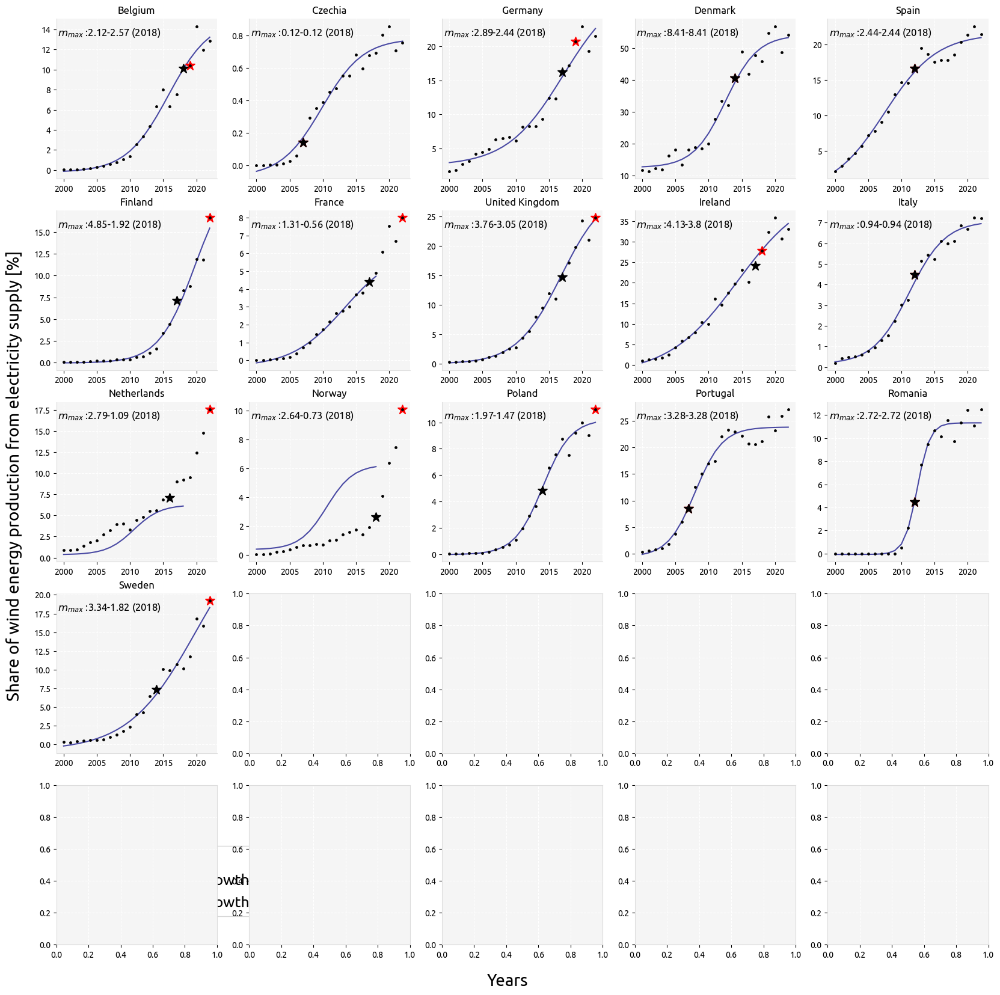

In [64]:
## figure S27
from scipy.optimize import curve_fit
from scipy.stats import linregress



def sigmoid(x, L ,x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return (y)

fig, axs = plt.subplots(5,5, figsize=(20,20), )
count2=0

for count,country in enumerate(sorted(countries)):   
  if  df_capacities.loc[('New-Solar w Equity',country),df_capacities.columns.str.contains('wind')].sum(axis=1).max()/1e3 > 20:
    i= int(count2/5)
    j=count2%5
    
    data_all = (df_historicalgen_IRENA.loc[(iso2name[country],['Offshore wind energy','Onshore wind energy']),:].sum(axis=0)*1e2/  ## 1e2 to percentage
             df_supply_IRENA.loc[iso2name[country],:].sum().squeeze())

    data_2018 = (df_historicalgen_IRENA.loc[(iso2name[country],['Offshore wind energy','Onshore wind energy']),:].sum(axis=0).loc[2000:2018]*1e2/  ## 1e2 to percentage
             df_supply_IRENA.loc[iso2name[country],:].sum().squeeze().loc[2000:2018])
        
    year0=data_all.index[0]
    ydata= data_all.values
    xdata= np.arange(len(ydata))
    
    ydata_2018= data_2018.values
    xdata_2018= np.arange(len(ydata_2018))
    
    max_slope= np.gradient(ydata).max()
    max_slope_2018= np.gradient(ydata_2018).max()
    
    max_slope_year= data_all.index[np.gradient(data_all.values).argmax()]
    max_slope_2018_year= data_2018.index[np.gradient(data_2018.values).argmax()]

    p0 = [max(ydata), np.median(xdata),1,min(ydata)] # this is an mandatory initial guess
    p0_2018 = [max(ydata_2018), np.median(xdata_2018),1,min(ydata_2018)] # this is an mandatory initial guess
    
    try:
       popt_2018, pcov_2018 = curve_fit(sigmoid, xdata_2018, ydata_2018,p0_2018, method='lm') #method='lm')
       midpoint_2018=int(popt_2018[1])
       slope_2018, intercept, r_value, p_value, std_err = linregress(xdata_2018[midpoint_2018-1 : midpoint_2018+2], 
                                                sigmoid(xdata_2018, *popt_2018)[midpoint_2018-1 : midpoint_2018+2]) 
    except :
       slope_2018 = 'na'
        
    try:
       popt, pcov = curve_fit(sigmoid, xdata, ydata,p0, method='lm') #method='lm')
       midpoint=int(popt[1])
       slope, intercept, r_value, p_value, std_err = linregress(xdata[midpoint-1 : midpoint+2], 
                                                         sigmoid(xdata, *popt)[midpoint-1 : midpoint+2])
    
       axs[i,j].plot((data_all.index), sigmoid(xdata, *popt), color='navy', label='fit', alpha=0.7)
       
    except :
       slope = 'na'
       axs[i,j].plot((data_2018.index), sigmoid(xdata_2018, *popt_2018), color='navy', label='fit', alpha=0.7)
       
        #print('no curve fit for: '+datatype+' , '+str(iso2name[country]))
    
    axs[i,j].plot(
        max_slope_year,
        data_all[max_slope_year],
        marker="*",
        markersize=12,
        markerfacecolor="red",
        markeredgecolor="red",
        label='Max growth'
    )
    axs[i,j].plot(
        max_slope_2018_year,
        data_2018[max_slope_2018_year],
        marker="*",
        markersize=12,
        markerfacecolor="black",
        markeredgecolor="black",
        label='Max growth till 2018'
    )
    if slope!='na' : slope = str(round(slope, 2))
    if slope_2018!='na' : slope_2018 = str(round(slope_2018, 2))
    #axs[i,j].text(.01, .99,  '$\Delta$ S: '+ slope +'-'+slope_2018+' (2018)', 
    #              ha='left', va='top',transform=axs[i,j].transAxes)
    
    axs[i,j].text(.01, .95, '$m_{max}$ :'+str(round(max_slope, 2))+'-'+str(round(max_slope_2018, 2))+' (2018)',
                  ha='left', va='top',transform=axs[i,j].transAxes, fontsize = 12) 

    axs[i,j].scatter(data_all.index, ydata, marker='o' ,s=6, color='k', zorder=3)
    axs[i,j].spines[['right', 'top']].set_visible(False)
    count2+=1
    axs[i,j].set_title(iso2name[country])
    
axs[i,j].legend(
        fancybox=True, fontsize=18, loc='center',  bbox_to_anchor=(1, -0.8), facecolor="white", frameon=True
    )

fig.text(0.5, 0.08, 'Years', ha='center', va='center', fontsize=20)
fig.text(0.09, 0.5, 'Share of wind energy production from electricity supply [%]', ha='center', va='center', rotation='vertical',fontsize=20)

In [ ]:
## main text figures

In [ ]:
##### Figure 5: cumulative installed capacity with IRENA :DC
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})
                     
fig, axs = plt.subplots(2,3, figsize=(15,7)) 
#fig.subplots_adjust(hspace=0.3)
count2=0   
  
    
for counter,country in enumerate(['ES','IT','GR','BE','DE','DK',]):   
    i= int(counter/3)
    j=counter%3
    axs[i,j].plot(years  ,
                df_capacities.loc['Base',country,:]['solar'].values/1e3 ,
                color=tech_colors['solar'],
                linestyle='-',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
                df_capacities.loc['Base w Equity',country,:]['solar'].values/1e3 ,
                color='orange',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
                df_capacities.loc['New-Solar w Equity',country,:]['solar'].values/1e3 ,
                color='red',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
            axs[i,j].plot( df_historical_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze()/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    count2+=1     
    axins = axs[i,j].inset_axes([0.07, 0.65, 0.35, 0.33],xticklabels=[])
    #xlim=(0, x2), ylim=(0, y2), xticklabels=[], yticklabels=[])
    axins.plot( df_historical_IRENA.loc[iso2name[country],'Solar photovoltaic'].squeeze()/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )  
    #yticks_def = axins.get_yticks() 
    #axins.set_yticks([i for i in yticks_def if i>0],va='top')
    #axins.set_yticklabels(['   '+str(i) for i in axins.get_yticks()],  horizontalalignment = "left",)# va='top', )
    #axins.tick_params(axis="y",direction="in", pad=-22)
    axins.yaxis.tick_right()

    axs[i,j].indicate_inset_zoom(axins, edgecolor="gainsboro") 
    
    axs[i][j].set_title(iso2name[country])

fig.text(0.5, 0.05, 'Years', ha='center', va='center', fontsize=16)
fig.text(0.07, 0.5, 'Installed capacity of Solar PV [GW$_\mathrm{DC}$]', ha='center', va='center',
         rotation='vertical',fontsize=16)


custom_lines = [Line2D([0], [0], color='k', linestyle='--', linewidth= 4),
                Line2D([0], [0], color=tech_colors['solar'], linestyle='--',  marker='o', linewidth= 4 ),
                Line2D([0], [0], color='orange',linestyle='--', marker='o', linewidth= 4 ),
                Line2D([0], [0], color='red',linestyle='--', marker='o', linewidth= 4 )]

plt.legend(custom_lines, ['historical', 'Base transition' , 'Transition W. 100% self-suff.',
                         'Transition W. alternative solar W. 100% self-suff.'],loc='center right',
           bbox_to_anchor=(0.5, 2.5),ncol=2,
           fontsize=14, frameon=False) 

axs[0,0].set_yticks(np.arange(0,1501, 500))
axs[0,2].set_yticks(np.arange(0,251, 50))
axs[1,1].set_yticks(np.arange(0,1201, 400))
axs[1,2].set_yticks(np.arange(0,51, 25))
#axins.set_yticks([i for i in yticks_def if i>0],va='top')
#axins.set_yticks([i for i in yticks_def if i>0],va='top')
#axins.set_yticks([i for i in yticks_def if i>0],va='top')
#axins.set_yticks([i for i in yticks_def if i>0],va='top')
#axins.set_yticks([i for i in yticks_def if i>0],va='top')

plt.show()        

# wind

/tmp/ipykernel_7261/38334035.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/38334035.py:18: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/38334035.py:27: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/38334035.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/38334035.py:18: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capa

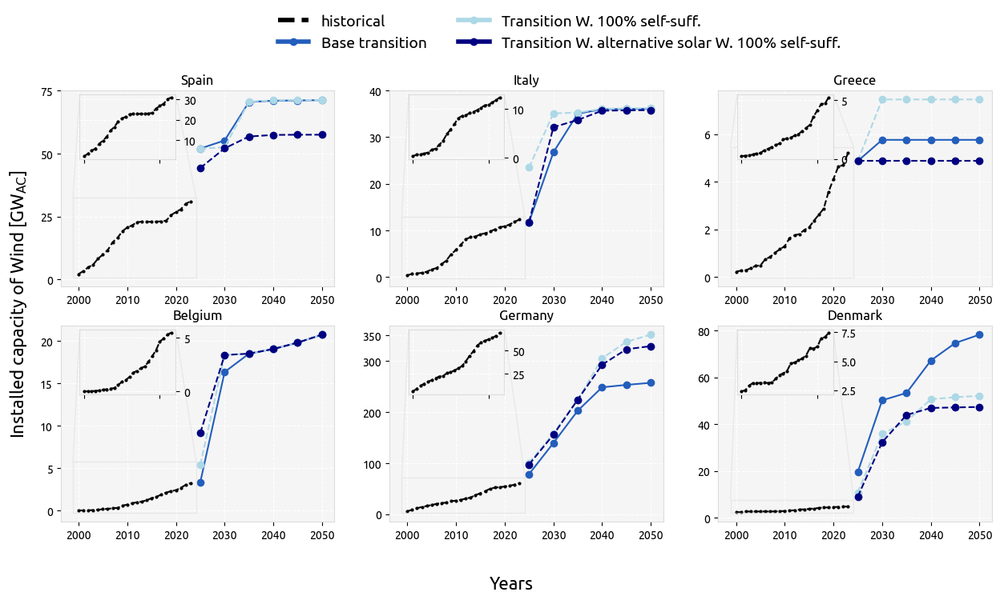

In [122]:
### Figure 6: cumulative installed capacity with IRENA

fig, axs = plt.subplots(2,3, figsize=(15,7)) 
count2=0   
    
for counter,country in enumerate(['ES','IT','GR','BE','DE','DK',]):   
    i= int(counter/3)
    j=counter%3   

    axs[i,j].plot(years  ,
                df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
                color=tech_colors['onwind'],
                marker='o',
                markersize=6,
                zorder=3,
                 )
    axs[i,j].plot(years  ,
                df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
                color='lightblue',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
               df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
                color='navy',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
               )
       
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
            axs[i,j].plot( df_historical_IRENA.loc[iso2name[country],'Onshore wind energy'].squeeze()/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    axs[i,j].set_title(iso2name[country])
    count2+=1
    axins = axs[i,j].inset_axes([0.07, 0.65, 0.35, 0.33], xticklabels=[])
    #xlim=(0, x2), ylim=(0, y2), xticklabels=[], yticklabels=[])
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
       axins.plot( (df_historical_IRENA.loc[iso2name[country],'Onshore wind energy'].squeeze()+
                  df_historical_IRENA.loc[iso2name[country],'Offshore wind energy'].fillna(0).sum().squeeze()
                           )/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    
    axins.yaxis.tick_right()

    axs[i,j].indicate_inset_zoom(axins, edgecolor="gainsboro") 
    
    axs[i][j].set_title(iso2name[country])
    
fig.text(0.5, 0.0, 'Years', ha='center', va='center', fontsize=16)
fig.text(0.09, 0.5, 'Installed capacity of Wind [GW$_\mathrm{AC}$]', ha='center', va='center', rotation='vertical',fontsize=16)

custom_lines = [Line2D([0], [0], color='k', linestyle='--',linewidth= 4 ),
                Line2D([0], [0], color=tech_colors['onwind'],  marker='o', linewidth= 4 ),
                Line2D([0], [0], color='lightblue', marker='o', linewidth= 4 ),
                Line2D([0], [0], color='navy', marker='o', linewidth= 4 ),]

plt.legend(custom_lines,  ['historical', 'Base transition' , 'Transition W. 100% self-suff.',
                         'Transition W. alternative solar W. 100% self-suff.'],loc='center right',
           bbox_to_anchor=(0.5, 2.5),ncol=2,
           fontsize=14, frameon=False) 

axs[0,0].set_yticks([0,25,50,75])
axs[0,1].set_yticks(np.arange(0,41, 10))
axs[1,1].set_yticks([0,100,200,300,350])
axs[1,2].set_yticks(np.arange(0,81, 20))

plt.show()        

/tmp/ipykernel_7261/1974321389.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:18: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:27: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:18: PerformanceWarning: indexing past lexsort depth may impact performance.

/tmp/ipykernel_7261/1974321389.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:18: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:27: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
/tmp/ipykernel_7261/1974321389.py:18: PerformanceWarning: indexing past lexsort depth may impact performance.

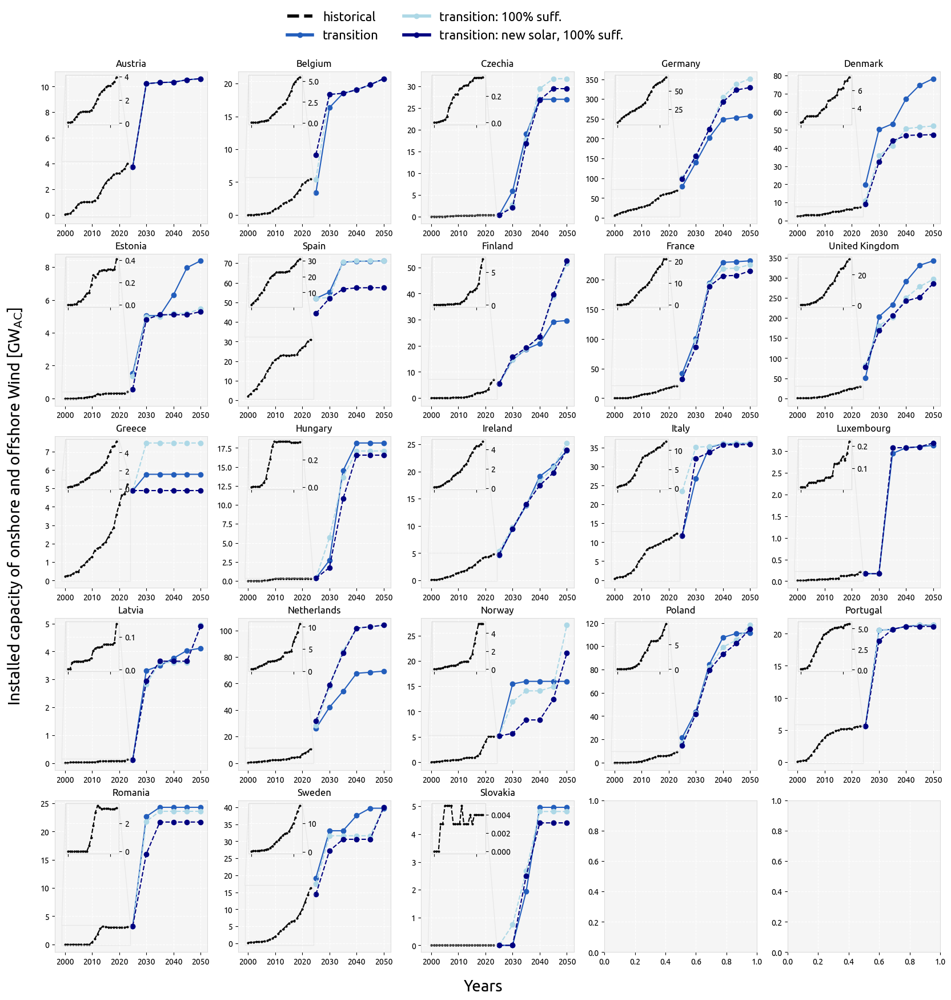

In [123]:
## Figure S24: cumulative installed capacity with IRENA : all wind

fig, axs = plt.subplots(5,5, figsize=(20,20)) 
count2=0   
    
for count,country in enumerate(sorted(countries)):   
  if  df_capacities.loc['Base w Equity',country,:]['onwind'].values.max()/1e3 > 3:
    i= int(count2/5)
    j=count2%5
    axs[i,j].plot(years  ,
                df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
                color=tech_colors['onwind'],
                marker='o',
                markersize=6,
                zorder=3,
                 )
    axs[i,j].plot(years  ,
                df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
                color='lightblue',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
               df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')].sum(axis=1).values/1e3 ,
                color='navy',
                linestyle='--',
                marker='o',
                markersize=6,
                zorder=3,
               )
       
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
            axs[i,j].plot( (df_historical_IRENA.loc[iso2name[country],'Onshore wind energy'].squeeze()+
                  df_historical_IRENA.loc[iso2name[country],'Offshore wind energy'].fillna(0).sum().squeeze())/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    axs[i][j].set_title(iso2name[country])
    #axs[i,j].set_yscale('symlog', base=2)
    axins = axs[i,j].inset_axes([0.07, 0.65, 0.35, 0.33],xticklabels=[])
    axins.plot( (df_historical_IRENA.loc[iso2name[country],'Onshore wind energy'].squeeze()+
                  df_historical_IRENA.loc[iso2name[country],'Offshore wind energy'].fillna(0).sum().squeeze()
                           )/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 ) 

    axins.yaxis.tick_right()

    axs[i,j].indicate_inset_zoom(axins, edgecolor="gainsboro")
    count2+=1
    
fig.text(0.5, 0.08, 'Years', ha='center', va='center', fontsize=20)
fig.text(0.09, 0.5, 'Installed capacity of onshore and offshore Wind [GW$_\mathrm{AC}$]', ha='center', va='center', rotation='vertical',fontsize=20)

custom_lines = [Line2D([0], [0], color='k', linestyle='--',linewidth= 4 ),
                Line2D([0], [0], color=tech_colors['onwind'],  marker='o', linewidth= 4 ),
                Line2D([0], [0], color='lightblue', marker='o', linewidth= 4 ),
                Line2D([0], [0], color='navy', marker='o', linewidth= 4 ),]

plt.legend(custom_lines, ['historical', 'transition' , 'transition: 100% suff.',
                         'transition: new solar, 100% suff.'],loc='center right',
           bbox_to_anchor=(-1, 6.1),ncol=2,
           fontsize=16, frameon=False) 


plt.show()        

/tmp/ipykernel_7261/3699775005.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  (df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')]
/tmp/ipykernel_7261/3699775005.py:20: PerformanceWarning: indexing past lexsort depth may impact performance.
  (df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')]
/tmp/ipykernel_7261/3699775005.py:30: PerformanceWarning: indexing past lexsort depth may impact performance.
  (df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')]
/tmp/ipykernel_7261/3699775005.py:11: PerformanceWarning: indexing past lexsort depth may impact performance.
  (df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')]
/tmp/ipykernel_7261/3699775005.py:20: PerformanceWarning: indexing past lexsort depth may impact performance.
  (df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')]
/tm

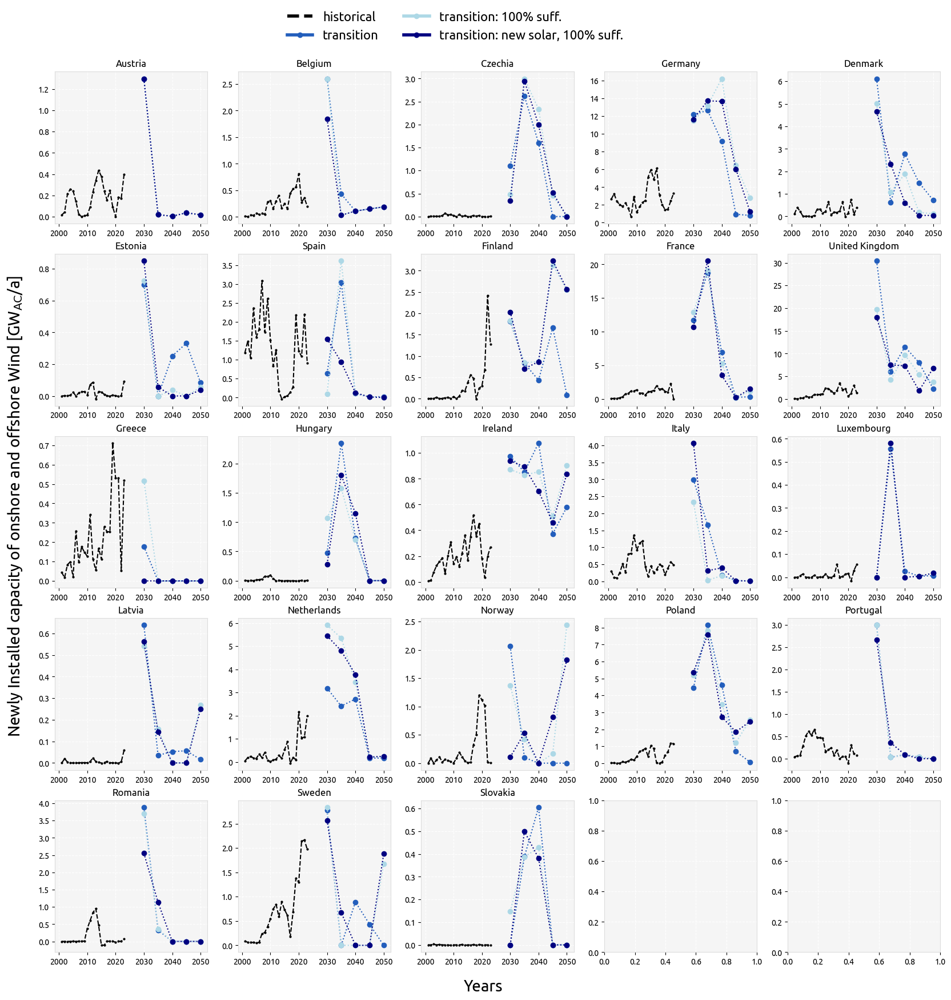

In [124]:
## Figure S25: new installed capacity with IRENA : all wind

fig, axs = plt.subplots(5,5, figsize=(20,20)) 
count2=0   
    
for count,country in enumerate(sorted(countries)):   
  if  df_capacities.loc['Base w Equity',country,:]['onwind'].values.max()/1e3 > 3:
    i= int(count2/5)
    j=count2%5
    axs[i,j].plot(years  ,
                (df_capacities.loc[('Base',country), df_capacities.columns.str.contains('wind')]
                  .sum(axis=1).diff().values/5/1e3) ,
                color=tech_colors['onwind'],
                marker='o',
                linestyle=':',
                markersize=6,
                zorder=3,
                 )
    axs[i,j].plot(years  ,
                (df_capacities.loc[('Base w Equity',country), df_capacities.columns.str.contains('wind')]
                  .sum(axis=1).diff().values/5/1e3) ,
                color='lightblue',
                linestyle=':',
                marker='o',
                markersize=6,
                zorder=3,
                 )
    
    axs[i,j].plot(years  ,
               (df_capacities.loc[('New-Solar w Equity',country), df_capacities.columns.str.contains('wind')]
                .sum(axis=1).diff().values/5/1e3) ,
                color='navy',
                linestyle=':',
                marker='o',
                markersize=6,
                zorder=3,
               )
       
    if iso2name[country] in df_historical_IRENA.index.get_level_values(0):
            axs[i,j].plot( (df_historical_IRENA.loc[iso2name[country],'Onshore wind energy'].squeeze()+
                  df_historical_IRENA.loc[iso2name[country],'Offshore wind energy'].fillna(0).sum().squeeze()
                           ).diff()/1e3 ,
                color= 'k', #tech_colors['solar'],
                linestyle='--',
                marker='o',
                markersize=2,
                zorder=3,
                 )
    axs[i][j].set_title(iso2name[country])

    count2+=1
    
fig.text(0.5, 0.08, 'Years', ha='center', va='center', fontsize=20)
fig.text(0.09, 0.5, 'Newly Installed capacity of onshore and offshore Wind [GW$_\mathrm{AC}$/a]', ha='center', va='center', rotation='vertical',fontsize=20)

custom_lines = [Line2D([0], [0], color='k', linestyle='--',linewidth= 4 ),
                Line2D([0], [0], color=tech_colors['onwind'],  marker='o', linewidth= 4 ),
                Line2D([0], [0], color='lightblue', marker='o', linewidth= 4 ),
                Line2D([0], [0], color='navy', marker='o', linewidth= 4 ),]

plt.legend(custom_lines, ['historical', 'transition' , 'transition: 100% suff.',
                         'transition: new solar, 100% suff.'],loc='center right',
           bbox_to_anchor=(-1, 6.1),ncol=2,
           fontsize=16, frameon=False) 


plt.show()        